In [1]:
import cv2
from cv2 import aruco
import numpy as np

# Load calibration data
calib_data_path = r"D:\calib_data_phone\MultiMatrix.npz"
calib_data = np.load(calib_data_path)
cam_mat = calib_data["camMatrix"]
dist_coef = calib_data["distCoef"]

marker_dict = aruco.getPredefinedDictionary(aruco.DICT_6X6_250)
MARKER_SIZE = 4.5  # Marker size in cm

# Load the image
image_path = r"D:\photos_from_phone\case_8.png"
frame = cv2.imread(image_path)

if frame is None:
    print("Error: Unable to load image.")
    exit()

# List to store curve points and angles with corners of markers
curve_points = []
angles_and_corners = []

# Flag to indicate when the mouse is being dragged
drawing = False

# Mouse callback function to draw curve lines on the image
def draw_curve(event, x, y, flags, param):
    global drawing

    if event == cv2.EVENT_LBUTTONDOWN:
        # Start drawing the curve
        drawing = True
        curve_points.append((x, y))
    elif event == cv2.EVENT_MOUSEMOVE and drawing:
        # Continue drawing the curve while dragging the mouse
        curve_points.append((x, y))
        cv2.circle(frame, (x, y), 1, (0, 255, 0), -1)
        cv2.imshow("Aruco Marker Detection with Curve Drawing", frame)
    elif event == cv2.EVENT_LBUTTONUP:
        # Stop drawing
        drawing = False

# Create a window and set the mouse callback function
cv2.namedWindow("Aruco Marker Detection with Curve Drawing")
cv2.setMouseCallback("Aruco Marker Detection with Curve Drawing", draw_curve)

gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
image_height, image_width, _ = frame.shape  # Get image dimensions

# Detect ArUco markers
marker_corners, marker_IDs, reject = aruco.detectMarkers(gray_image, marker_dict)

if marker_corners:
    # Iterate over each detected marker
    rVec, tVec, _ = aruco.estimatePoseSingleMarkers(marker_corners, MARKER_SIZE, cam_mat, dist_coef)
    
    # Loop over markers to store angles and corner data for two markers
    for i, (corners, marker_id) in enumerate(zip(marker_corners, marker_IDs)):
        # Stop at two markers
        if i >= 2:
            break

        corners = corners.reshape(4, 2)
        top_left, top_right, bottom_right, bottom_left = corners
        
        # 1. Calculate centroid of the marker (mean of the corners)
        centroid_x = int(np.mean(corners[:, 0]))
        centroid_y = int(np.mean(corners[:, 1]))
        centroid = (centroid_x, centroid_y)

        # Draw centroid on the image
        cv2.circle(frame, centroid, 3, (0, 0, 255), -1)
        
        # 2. Calculate the angle of rotation using the top edge (top-left to top-right)
        delta_y = top_right[1] - top_left[1]
        delta_x = top_right[0] - top_left[0]
        angle = np.degrees(np.arctan2(delta_y, delta_x))
        
        # Display the angle on the image
        cv2.putText(frame, f"Angle: {int(angle)}", (int(top_right[0]), int(top_right[1] - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
        
        print(f"Marker ID: {marker_id[0]}, Centroid: {centroid}, Angle of Rotation: {angle:.2f} degrees")

        # Store angle and corner points for two markers
        marker_data = {
            "marker_id": marker_id[0],
            "angle": angle,
            "corners": {
                "top_left": tuple(top_left),
                "top_right": tuple(top_right),
                "bottom_right": tuple(bottom_right),
                "bottom_left": tuple(bottom_left)
            },
            "centroid": centroid
        }
        angles_and_corners.append(marker_data)

        # Draw marker outline and axes
        cv2.polylines(frame, [corners.astype(np.int32)], True, (0, 255, 255), 1, cv2.LINE_AA)
        cv2.line(frame, (int(top_left[0]), int(top_left[1])), (int(top_right[0]), int(top_right[1])), (255, 0, 255), 1)

# Display the result
cv2.imshow("Aruco Marker Detection with Curve Drawing", frame)

# Wait for key press to close window
cv2.waitKey(0)
cv2.destroyAllWindows()

# Save the result image
output_image_path = r"D:\path_to_save_output_image.jpg"
cv2.imwrite(output_image_path, frame)

# Save the curve points and marker data into a file
output_data_path = r"D:\arm_bot_numpy_files\case_8.npz"
np.savez(output_data_path, curve_points=curve_points, angles_and_corners=angles_and_corners)

# Print saved data for confirmation
print(f"Curve Points: {curve_points}")
print(f"Angles and Corners: {angles_and_corners}")


Marker ID: 100, Centroid: (1120, 426), Angle of Rotation: 1.33 degrees
Marker ID: 80, Centroid: (621, 183), Angle of Rotation: -167.28 degrees
Curve Points: []
Angles and Corners: [{'marker_id': 100, 'angle': 1.3322198, 'corners': {'top_left': (1099.0, 406.0), 'top_right': (1142.0, 407.0), 'bottom_right': (1141.0, 447.0), 'bottom_left': (1099.0, 445.0)}, 'centroid': (1120, 426)}, {'marker_id': 80, 'angle': -167.27563, 'corners': {'top_left': (633.0, 203.0), 'top_right': (602.0, 196.0), 'bottom_right': (610.0, 164.0), 'bottom_left': (642.0, 170.0)}, 'centroid': (621, 183)}]


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the saved data from the .npz file
data_path = r"D:\arm_bot_numpy_files\case_8.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the selected coordinates and angles/corners of markers
selected_coordinates = data["curve_points"]
angles_and_corners = data["angles_and_corners"]

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates
all_x_coords = []
all_y_coords = []

# Loop through the angles and corners to plot the rectangles
for marker_data in angles_and_corners:
    corners = marker_data["corners"]
    
    # Extract the corner points
    top_left = corners["top_left"]
    top_right = corners["top_right"]
    bottom_right = corners["bottom_right"]
    bottom_left = corners["bottom_left"]
    
    # Add corner points to the lists of all x and y coordinates
    all_x_coords.extend([top_left[0], top_right[0], bottom_right[0], bottom_left[0]])
    all_y_coords.extend([top_left[1], top_right[1], bottom_right[1], bottom_left[1]])

    # Create a rectangle patch based on the corner points
    width = np.linalg.norm(np.array(top_right) - np.array(top_left))  # Distance between top_left and top_right
    height = np.linalg.norm(np.array(bottom_left) - np.array(top_left))  # Distance between top_left and bottom_left
    
    # Create a patch (rotated rectangle) using the width, height, and angle
    angle_of_rotation = marker_data["angle"]
    
    # Create the rectangle at top-left with a rotation angle
    rect = patches.Rectangle(
        top_left, width, height, angle=angle_of_rotation, 
        linewidth=1, edgecolor='r', facecolor='none'
    )
    ax.plot([top_left[0], top_right[0]], [top_left[1], top_right[1]], color='blue', linewidth=1)
    
    # Add the rectangle to the plot
    ax.add_patch(rect)

# Plot the selected coordinates
for coord in selected_coordinates:
    ax.plot(coord[0], coord[1], 'go')  # Green point for selected coordinates
    all_x_coords.append(coord[0])
    all_y_coords.append(coord[1])

# Set the plot limits based on the range of the x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the saved data from the .npz file
data_path = r"D:\arm_bot_numpy_files\case_7.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the selected coordinates and angles/corners of markers
selected_coordinates = data["curve_points"]
angles_and_corners = data["angles_and_corners"]

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates
all_x_coords = []
all_y_coords = []

# Initialize lists to store transformed rectangles and points
transformed_rectangles = []
transformed_points = []

# Calculate the centroid of the first rectangle (for shifting)
first_marker_data = angles_and_corners[0]
first_corners = first_marker_data["corners"]

# Compute the centroid of the first rectangle
top_left = np.array(first_corners["top_left"])
top_right = np.array(first_corners["top_right"])
bottom_right = np.array(first_corners["bottom_right"])
bottom_left = np.array(first_corners["bottom_left"])

centroid_x = (top_left[0] + top_right[0] + bottom_right[0] + bottom_left[0]) / 4
centroid_y = (top_left[1] + top_right[1] + bottom_right[1] + bottom_left[1]) / 4
centroid = np.array([centroid_x, centroid_y])

print(f"Centroid of the first rectangle: {centroid}")

# Get the rotation angle of the first rectangle
first_angle = first_marker_data["angle"]
print(f"Angle of the first rectangle: {first_angle} degrees")

# Convert the angle to radians for the rotation matrix
theta = np.radians(-first_angle)

# Rotation matrix for counter-clockwise rotation
rotation_matrix = np.array([
    [np.cos(theta), -np.sin(theta)],
    [np.sin(theta), np.cos(theta)]
])

# Function to shift and rotate coordinates
def shift_and_rotate(coord, centroid, rotation_matrix):
    shifted_coord = coord - centroid  # Shift to centroid
    rotated_coord = np.dot(rotation_matrix, shifted_coord)  # Apply rotation
    return rotated_coord

# Loop through the angles and corners to plot the rectangles with shifted and rotated coordinates
angles_and_corners_r=[]
for marker_data in angles_and_corners:
    corners = marker_data["corners"]
    marker_id=marker_data["marker_id"]
    
    # Extract and shift the corner points
    top_left_shifted = shift_and_rotate(np.array(corners["top_left"]), centroid, rotation_matrix)
    top_right_shifted = shift_and_rotate(np.array(corners["top_right"]), centroid, rotation_matrix)
    bottom_right_shifted = shift_and_rotate(np.array(corners["bottom_right"]), centroid, rotation_matrix)
    bottom_left_shifted = shift_and_rotate(np.array(corners["bottom_left"]), centroid, rotation_matrix)
    
    # Add shifted and rotated corner points to the lists of all x and y coordinates
    all_x_coords.extend([top_left_shifted[0], top_right_shifted[0], bottom_right_shifted[0], bottom_left_shifted[0]])
    all_y_coords.extend([top_left_shifted[1], top_right_shifted[1], bottom_right_shifted[1], bottom_left_shifted[1]])

    # Store the transformed rectangle coordinates
    transformed_rectangles.append({
        "top_left": top_left_shifted,
        "top_right": top_right_shifted,
        "bottom_right": bottom_right_shifted,
        "bottom_left": bottom_left_shifted
    })

    # Create a rectangle patch based on the shifted and rotated corner points
    width = np.linalg.norm(top_right_shifted - top_left_shifted)  # Distance between top_left and top_right
    height = np.linalg.norm(bottom_left_shifted - top_left_shifted)  # Distance between top_left and bottom_left
    delta_y = top_right_shifted[1] - top_left_shifted[1]
    delta_x = top_right_shifted[0] - top_left_shifted[0]
    angle = np.degrees(np.arctan2(delta_y, delta_x))
    # Create the rectangle at the shifted and rotated top-left (rotation is now 0)
    rect = patches.Rectangle(
        top_left_shifted, width, height, angle=angle, 
        linewidth=1, edgecolor='r', facecolor='none'
    )
    ax.plot([top_left_shifted[0], top_right_shifted[0]], [top_left_shifted[1], top_right_shifted[1]], color='blue', linewidth=1)
    centroid_x_r = (top_left_shifted[0] + top_right_shifted[0] + bottom_right_shifted[0] + bottom_left_shifted[0]) / 4
    centroid_y_r = (top_left_shifted[1] + top_right_shifted[1] + bottom_right_shifted[1] + bottom_left_shifted[1]) / 4
    centroid_r = np.array([centroid_x_r, centroid_y_r])
    
    # Add the rectangle to the plot
    ax.add_patch(rect)
    marker_data_r = {
            "marker_id": marker_id,
            "angle": angle,
            "corners": {
                "top_left": tuple(top_left_shifted),
                "top_right": tuple(top_right_shifted),
                "bottom_right": tuple(bottom_right_shifted),
                "bottom_left": tuple(bottom_left_shifted)
            },
            "centroid": centroid_r
        }
    angles_and_corners_r.append(marker_data_r)

# Plot the selected coordinates with the same shift and rotation applied
for coord in selected_coordinates:
    coord_shifted_rotated = shift_and_rotate(np.array(coord), centroid, rotation_matrix)
    ax.plot(coord_shifted_rotated[0], coord_shifted_rotated[1], 'go')  # Green point for selected coordinates
    all_x_coords.append(coord_shifted_rotated[0])
    all_y_coords.append(coord_shifted_rotated[1])
    
    # Store the transformed points
    transformed_points.append(coord_shifted_rotated)

# Set the plot limits based on the range of the shifted and rotated x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points (Shifted and Rotated to Align with Origin)")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()
coordinates = np.array(transformed_points)

# Number of points you want to downsample to
target_points = 500

# Calculate the indices to sample based on total number of points
total_points = coordinates.shape[0]
indices = np.linspace(0, total_points - 1, target_points, dtype=int)

# Downsample the array
downsampled_coordinates = coordinates[indices]
# Save the transformed data in a new .npz file
save_path = r"D:\arm_bot_numpy_files\transformed_case_7.npz"
np.savez(save_path, transformed_angles_and_corners=angles_and_corners_r, transformed_curve_points=downsampled_coordinates)

print(f"Transformed data saved to {save_path}")


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the saved data from the .npz file
data_path = r"D:\arm_bot_numpy_files\transformed_case_8.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the selected coordinates and angles/corners of markers
selected_coordinates = data["transformed_curve_points"]
angles_and_corners = data["transformed_angles_and_corners"]

new_column = np.arange(0.001, 0.001 * (len(selected_coordinates) + 1), 0.001).reshape(-1, 1)

# Concatenate the original array with the new column
selected_coordinates_time= np.hstack((selected_coordinates, new_column))

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates
all_x_coords = []
all_y_coords = []

# Loop through the angles and corners to plot the rectangles
for marker_data in angles_and_corners:
    corners = marker_data["corners"]
    
    # Extract the corner points
    top_left = corners["top_left"]
    top_right = corners["top_right"]
    bottom_right = corners["bottom_right"]
    bottom_left = corners["bottom_left"]
    
    # Add corner points to the lists of all x and y coordinates
    all_x_coords.extend([top_left[0], top_right[0], bottom_right[0], bottom_left[0]])
    all_y_coords.extend([top_left[1], top_right[1], bottom_right[1], bottom_left[1]])

    # Create a rectangle patch based on the corner points
    width = np.linalg.norm(np.array(top_right) - np.array(top_left))  # Distance between top_left and top_right
    height = np.linalg.norm(np.array(bottom_left) - np.array(top_left))  # Distance between top_left and bottom_left
    
    # Create a patch (rotated rectangle) using the width, height, and angle
    angle_of_rotation = marker_data["angle"]
    
    # Create the rectangle at top-left with a rotation angle
    rect = patches.Rectangle(
        top_left, width, height, angle=angle_of_rotation, 
        linewidth=1, edgecolor='r', facecolor='none'
    )
    ax.plot([top_left[0], top_right[0]], [top_left[1], top_right[1]], color='blue', linewidth=1)
    
    # Add the rectangle to the plot
    ax.add_patch(rect)

# Plot the selected coordinates
for coord in selected_coordinates:
    ax.plot(coord[0], coord[1], 'go')  # Green point for selected coordinates
    all_x_coords.append(coord[0])
    all_y_coords.append(coord[1])

# Set the plot limits based on the range of the x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')
save_path = r"D:\arm_bot_numpy_files\transformed_case_8_with_time.npz"
np.savez(save_path, transformed_angles_and_corners=angles_and_corners, transformed_curve_points_time=selected_coordinates_time)

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()


In [2]:


import numpy as np
import scipy.io
import os

def path_planning_function(angles_and_corners_r):

    pTmp = []
    for item in angles_and_corners_r:
        marker_id = item['marker_id']
        angle = item['angle']
        
        centroid = np.array([0, item['centroid'][0][0], item['centroid'][0][1]])
        angle_radians = np.deg2rad(angle + 180)
        rotation_matrix = np.array([
            [1, 0, 0],
            [0, np.cos(angle_radians), -np.sin(angle_radians)],
            [0, np.sin(angle_radians), np.cos(angle_radians)]
        ])
        pTmp.append({
            'A': rotation_matrix,
            'b': centroid * 1e-3
        })
        print(f'Marker ID: {marker_id}')
        print(f'Angle: {angle:.2f}')
        print('Centroid:')
        print(centroid)

    # Load SigmaGMR and MuGMR
    SigmaGMR = scipy.io.loadmat(r"D:\pathplanning_trained_Files\large_file_straight_lines\train_1_20\SigmaGMR.mat")['SigmaGMR']
    MuGMR = scipy.io.loadmat(r"D:\pathplanning_trained_Files\large_file_straight_lines\train_1_20\MuGMR.mat")['MuGMR']

    if SigmaGMR is None:
        raise ValueError('SigmaGMR not found in the .mat file.')
    if MuGMR is None:
        raise ValueError('MuGMR not found in the .mat file.')

    model = {
        'nbStates': 20,
        'nbFrames': 2,
        'nbVar': 3,
        'params_diagRegFact': 1E-4
    }
    nbData = 500
    print('Reproductions with GMR...')
    nbSamples = 8
    in_var = 0
    out = slice(1, model['nbVar'])

    trajectory_data = []

    for n in range(1):
        MuTmp = np.zeros((len(range(*out.indices(model['nbVar']))), nbData, model['nbFrames']))
        SigmaTmp = np.zeros((len(range(*out.indices(model['nbVar']))), len(range(*out.indices(model['nbVar']))), nbData, model['nbFrames']))
        r = {'p': pTmp}

        for m in range(model['nbFrames']):
            MuTmp[:,:,m] = pTmp[m]['A'][1:, 1:] @ MuGMR[:,:,m] + np.tile(pTmp[m]['b'][1:, np.newaxis], (1, nbData))
            for t in range(nbData):
                SigmaTmp[:,:,t,m] = pTmp[m]['A'][1:, 1:] @ SigmaGMR[:,:,t,m] @ pTmp[m]['A'][1:, 1:].T

        r['Sigma'] = np.zeros((len(range(*out.indices(model['nbVar']))), len(range(*out.indices(model['nbVar']))), nbData))
        r['Data'] = np.zeros((len(range(*out.indices(model['nbVar']))), nbData))

        for t in range(nbData):
            SigmaP = np.zeros((len(range(*out.indices(model['nbVar']))), len(range(*out.indices(model['nbVar'])))))
            MuP = np.zeros((len(range(*out.indices(model['nbVar']))), 1))
            for m in range(model['nbFrames']):
                SigmaP += np.linalg.inv(SigmaTmp[:,:,t,m])
                MuP += np.linalg.solve(SigmaTmp[:,:,t,m], MuTmp[:,t,m][:, np.newaxis])
            r['Sigma'][:,:,t] = np.linalg.inv(SigmaP)
            r['Data'][:,t] = r['Sigma'][:,:,t] @ MuP.flatten()

        print('Data:')
        print(r['Data'])
        trajectory_data.append(r['Data'])

    return np.concatenate(trajectory_data, axis=1)


import matlab.engine
import cv2
from cv2 import aruco
import numpy as np

# Load calibration data
calib_data_path = r"D:\calib_data_phone\MultiMatrix.npz"
calib_data = np.load(calib_data_path)
cam_mat = calib_data["camMatrix"]
dist_coef = calib_data["distCoef"]
url="https://10.0.55.61:8080/video"

marker_dict = aruco.getPredefinedDictionary(aruco.DICT_6X6_250)
MARKER_SIZE = 4.5  


cap = cv2.VideoCapture(url)  
if not cap.isOpened():
    print("Error: Could not open webcam.")
    exit()

angles_and_corners = []

while True:
    ret, frame = cap.read()
    if not ret:
        print("Error: Unable to read frame.")
        break


    angles_and_corners = []



    gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    image_height, image_width, _ = frame.shape  

  
    marker_corners, marker_IDs, reject = aruco.detectMarkers(gray_image, marker_dict)

    if marker_corners and len(marker_IDs)==2:
       
        rVec, tVec, _ = aruco.estimatePoseSingleMarkers(marker_corners, MARKER_SIZE, cam_mat, dist_coef)
        
       
        for i, (corners, marker_id) in enumerate(zip(marker_corners, marker_IDs)):
           
            if i >= 2:
                break

            corners = corners.reshape(4, 2)
            top_left, top_right, bottom_right, bottom_left = corners
            
          
            centroid_x = int(np.mean(corners[:, 0]))
            centroid_y = int(np.mean(corners[:, 1]))
            centroid = (centroid_x, centroid_y)

         
            cv2.circle(frame, centroid, 3, (0, 0, 255), -1)
            
            
            delta_y = top_right[1] - top_left[1]
            delta_x = top_right[0] - top_left[0]
            angle = np.degrees(np.arctan2(delta_y, delta_x))
            
        
            cv2.putText(frame, f"Angle: {int(angle)}", (int(top_right[0]), int(top_right[1] - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
            
            print(f"Marker ID: {marker_id[0]}, Centroid: {centroid}, Angle of Rotation: {angle:.2f} degrees")

            
            marker_data = {
                "marker_id": marker_id[0],
                "angle": angle,
                "corners": {
                    "top_left": tuple(top_left),
                    "top_right": tuple(top_right),
                    "bottom_right": tuple(bottom_right),
                    "bottom_left": tuple(bottom_left)
                },
                "centroid": centroid
            }
            angles_and_corners.append(marker_data)

        
            cv2.polylines(frame, [corners.astype(np.int32)], True, (0, 255, 255), 1, cv2.LINE_AA)
            cv2.line(frame, (int(top_left[0]), int(top_left[1])), (int(top_right[0]), int(top_right[1])), (255, 0, 255), 1)





        transformed_rectangles = []
        transformed_points = []
        all_x_coords = []
        all_y_coords = []
        first_marker_data = angles_and_corners[0]
        first_corners = first_marker_data["corners"]

        top_left = np.array(first_corners["top_left"])
        top_right = np.array(first_corners["top_right"])
        bottom_right = np.array(first_corners["bottom_right"])
        bottom_left = np.array(first_corners["bottom_left"])

        centroid_x = (top_left[0] + top_right[0] + bottom_right[0] + bottom_left[0]) / 4
        centroid_y = (top_left[1] + top_right[1] + bottom_right[1] + bottom_left[1]) / 4
        centroid = np.array([centroid_x, centroid_y])

        print(f"Centroid of the first rectangle: {centroid}")

    
        first_angle = first_marker_data["angle"]
        print(f"Angle of the first rectangle: {first_angle} degrees")

 
        theta = np.radians(-first_angle)

     
        rotation_matrix = np.array([
            [np.cos(theta), -np.sin(theta)],
            [np.sin(theta), np.cos(theta)]
        ])

        
        def shift_and_rotate(coord, centroid, rotation_matrix):
            shifted_coord = coord - centroid  
            rotated_coord = np.dot(rotation_matrix, shifted_coord)  
            return rotated_coord

    
        angles_and_corners_r=[]
        angles_and_corners_r_matlab=[]
        for marker_data in angles_and_corners:
            corners = marker_data["corners"]
            marker_id=marker_data["marker_id"]
            
            
            top_left_shifted = shift_and_rotate(np.array(corners["top_left"]), centroid, rotation_matrix)
            top_right_shifted = shift_and_rotate(np.array(corners["top_right"]), centroid, rotation_matrix)
            bottom_right_shifted = shift_and_rotate(np.array(corners["bottom_right"]), centroid, rotation_matrix)
            bottom_left_shifted = shift_and_rotate(np.array(corners["bottom_left"]), centroid, rotation_matrix)
            
            
            all_x_coords.extend([top_left_shifted[0], top_right_shifted[0], bottom_right_shifted[0], bottom_left_shifted[0]])
            all_y_coords.extend([top_left_shifted[1], top_right_shifted[1], bottom_right_shifted[1], bottom_left_shifted[1]])

            
            transformed_rectangles.append({
                "top_left": top_left_shifted,
                "top_right": top_right_shifted,
                "bottom_right": bottom_right_shifted,
                "bottom_left": bottom_left_shifted
            })

            
            width = np.linalg.norm(top_right_shifted - top_left_shifted)  
            height = np.linalg.norm(bottom_left_shifted - top_left_shifted)  
            delta_y = top_right_shifted[1] - top_left_shifted[1]
            delta_x = top_right_shifted[0] - top_left_shifted[0]
            angle = np.degrees(np.arctan2(delta_y, delta_x))

            centroid_x_r = (top_left_shifted[0] + top_right_shifted[0] + bottom_right_shifted[0] + bottom_left_shifted[0]) / 4
            centroid_y_r = (top_left_shifted[1] + top_right_shifted[1] + bottom_right_shifted[1] + bottom_left_shifted[1]) / 4
            centroid_r = np.array([centroid_x_r, centroid_y_r])
            

            marker_data_r = {
                    "marker_id": marker_id,
                    "angle": angle,
                    "corners": {
                        "top_left": tuple(top_left_shifted),
                        "top_right": tuple(top_right_shifted),
                        "bottom_right": tuple(bottom_right_shifted),
                        "bottom_left": tuple(bottom_left_shifted)
                    },
                    "centroid": centroid_r
                }
            
            angles_and_corners_r_matlab.append({
                "marker_id":marker_id,
                "angle": angle,
                "centroid": matlab.double(list(centroid_r))
            })

            
        
            
            angles_and_corners_r.append(marker_data_r)


    
        data=path_planning_function(angles_and_corners_r_matlab)
        print(data)
        np_data=np.array(data)
        print(np_data.shape)
        np_data[0, :]=np_data[0, :]*1000
        np_data[1, :]=np_data[1, :]*1000
        if np_data.shape[0] == 2:
            x_data = np_data[0, :]
            y_data = np_data[1, :]
        else:
            print("Error: np_data does not have the expected shape.")
            x_data, y_data = [], []  


        arr_transposed = np.transpose(np_data)
        np_data_list=arr_transposed.tolist()




        
        def reverse_shift_and_rotate(coord, centroid, rotation_matrix):
        
            rotated_back = np.dot(rotation_matrix.T, coord)
    
            original_coord = rotated_back + centroid
            return original_coord

        
        reversed_rectangles = []
        reversed_points = []

        
        for transformed_rectangle in transformed_rectangles:
            top_left_reversed = reverse_shift_and_rotate(np.array(transformed_rectangle["top_left"]), centroid, rotation_matrix)
            top_right_reversed = reverse_shift_and_rotate(np.array(transformed_rectangle["top_right"]), centroid, rotation_matrix)
            bottom_right_reversed = reverse_shift_and_rotate(np.array(transformed_rectangle["bottom_right"]), centroid, rotation_matrix)
            bottom_left_reversed = reverse_shift_and_rotate(np.array(transformed_rectangle["bottom_left"]), centroid, rotation_matrix)
            
            reversed_rectangles.append({
                "top_left": top_left_reversed,
                "top_right": top_right_reversed,
                "bottom_right": bottom_right_reversed,
                "bottom_left": bottom_left_reversed
            })

        
        for transformed_point in np_data_list:
            reversed_point = reverse_shift_and_rotate(np.array(transformed_point), centroid, rotation_matrix)
            reversed_points.append(reversed_point)


        for reversed_rectangle in reversed_rectangles:
            top_left = reversed_rectangle["top_left"]
            top_right = reversed_rectangle["top_right"]
            bottom_right = reversed_rectangle["bottom_right"]
            bottom_left = reversed_rectangle["bottom_left"]

            
            width = np.linalg.norm(top_right - top_left)  
            height = np.linalg.norm(bottom_left - top_left)  
            delta_y = top_right[1] - top_left[1]
            delta_x = top_right[0] - top_left[0]
            angle = np.degrees(np.arctan2(delta_y, delta_x))




        print("length",len(reversed_points))



        for point in reversed_points:
            x, y = point  
            print(x, y)
            cv2.circle(frame, (int(x), int(y)), radius=5, color=(0, 255, 0), thickness=-1)  

    origi_frame=frame.copy()
    frame_display=frame.copy()
    screen_res=1280,720
    height,width=frame.shape[:2]
    scale=min(screen_res[0]/width,screen_res[1]/height)
    dim=(int(width*scale),int(height*scale))
    frame_resized=cv2.resize(frame_display,dim,interpolation=cv2.INTER_AREA)

    cv2.namedWindow("Image",cv2.WINDOW_NORMAL)
    cv2.resizeWindow("Image",dim[0],dim[1])

    cv2.imshow("Image",origi_frame)




    if cv2.waitKey(1) & 0xFF == ord('q'):
        break


cv2.destroyAllWindows()


Marker ID: 100, Centroid: (1241, 607), Angle of Rotation: 149.60 degrees
Marker ID: 80, Centroid: (643, 960), Angle of Rotation: -12.85 degrees
Centroid of the first rectangle: [1241.75  607.25]
Angle of the first rectangle: 149.6012725830078 degrees
Marker ID: 100
Angle: -0.00
Centroid:
[0. 0. 0.]
Marker ID: 80
Angle: -162.45
Centroid:
[  0.         694.62866502  -1.748109  ]
Reproductions with GMR...
Data:
[[ 0.68349588  0.68326088  0.68301623  0.68276062  0.68249261  0.68221056
   0.6819127   0.68159707  0.68126153  0.68090378  0.68052137  0.6801117
   0.67967208  0.67919979  0.67869208  0.67814633  0.67756008  0.67693115
   0.67625776  0.67553864  0.67477314  0.67396128  0.67310387  0.67220247
   0.67125939  0.67027762  0.66926063  0.66821227  0.66713648  0.66603712
   0.66491767  0.66378109  0.66262959  0.66146458  0.66028655  0.6590951
   0.657889    0.6566663   0.65542444  0.65416048  0.65287122  0.65155346
   0.65020414  0.64882056  0.6474005   0.64594238  0.64444536  0.6429093

update path planning


In [44]:
import cv2
from cv2 import aruco
import numpy as np

# Load calibration data
calib_data_path = r"D:\calib_data_phone\MultiMatrix.npz"
calib_data = np.load(calib_data_path)
cam_mat = calib_data["camMatrix"]
dist_coef = calib_data["distCoef"]

marker_dict = aruco.getPredefinedDictionary(aruco.DICT_6X6_250)
MARKER_SIZE = 4.5  # Marker size in cm

# Load the image
image_path = r"D:\webcam_saved_images\saved_image_52.jpg"
frame = cv2.imread(image_path)

if frame is None:
    print("Error: Unable to load image.")
    exit()

# List to store selected points, line coordinates, and marker data
selected_points = []
line_coordinates = []
angles_and_corners = []

# Function to get all pixel coordinates along a line between two points
def get_line_coordinates(p1, p2):
    # Use np.linspace to interpolate points between p1 and p2
    x_coords = np.linspace(p1[0], p2[0], num=int(np.hypot(p2[0] - p1[0], p2[1] - p1[1]))).astype(int)
    y_coords = np.linspace(p1[1], p2[1], num=int(np.hypot(p2[0] - p1[0], p2[1] - p1[1]))).astype(int)
    
    # Zip the x and y coordinates to create the list of points along the line
    points_along_line = list(zip(x_coords, y_coords))
    
    return points_along_line

# Mouse callback function to select points and draw lines between consecutive points
def select_and_draw_points(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:
        # Append the selected point
        selected_points.append((x, y))

        # Draw a small circle at the selected point
        cv2.circle(frame, (x, y), 3, (0, 255, 0), -1)

        # If more than one point is selected, draw a line between the last two points
        if len(selected_points) > 1:
            p1 = selected_points[-2]
            p2 = selected_points[-1]
            
            # Draw the line between p1 and p2
            cv2.line(frame, p1, p2, (255, 0, 0), 2)
            
            # Get all coordinates along the line
            line_coords = get_line_coordinates(p1, p2)
            line_coordinates.extend(line_coords)  # Store all line coordinates

        # Display the updated image
        cv2.imshow("Aruco Marker Detection with Point Selection", frame)

origi_frame=frame.copy()
frame_display=frame.copy()
screen_res=1280,720
height,width=frame.shape[:2]
scale=min(screen_res[0]/width,screen_res[1]/height)
dim=(int(width*scale),int(height*scale))
frame_resized=cv2.resize(frame_display,dim,interpolation=cv2.INTER_AREA)

# cv2.namedWindow("Image",cv2.WINDOW_NORMAL)
# cv2.resizeWindow("Image",dim[0],dim[1])

# cv2.imshow("Image",origi_frame)        

# Create a window and set the mouse callback function
cv2.namedWindow("Aruco Marker Detection with Point Selection",cv2.WINDOW_NORMAL)
cv2.resizeWindow("Aruco Marker Detection with Point Selection",dim[0],dim[1])
cv2.setMouseCallback("Aruco Marker Detection with Point Selection", select_and_draw_points)

gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
image_height, image_width, _ = frame.shape  # Get image dimensions

# Detect ArUco markers
marker_corners, marker_IDs, reject = aruco.detectMarkers(gray_image, marker_dict)

if marker_corners:
    # Iterate over each detected marker
    rVec, tVec, _ = aruco.estimatePoseSingleMarkers(marker_corners, MARKER_SIZE, cam_mat, dist_coef)
    
    # Loop over markers to store angles and corner data for two markers
    for i, (corners, marker_id) in enumerate(zip(marker_corners, marker_IDs)):
        # Stop at two markers
        if i >= 2:
            break

        corners = corners.reshape(4, 2)
        top_left, top_right, bottom_right, bottom_left = corners
        
        # 1. Calculate centroid of the marker (mean of the corners)
        centroid_x = int(np.mean(corners[:, 0]))
        centroid_y = int(np.mean(corners[:, 1]))
        centroid = (centroid_x, centroid_y)

        # Draw centroid on the image
        cv2.circle(frame, centroid, 3, (0, 0, 255), -1)
        
        # 2. Calculate the angle of rotation using the top edge (top-left to top-right)
        delta_y = top_right[1] - top_left[1]
        delta_x = top_right[0] - top_left[0]
        angle = np.degrees(np.arctan2(delta_y, delta_x))
        
        # Display the angle on the image
        cv2.putText(frame, f"Angle: {int(angle)}", (int(top_right[0]), int(top_right[1] - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
        
        print(f"Marker ID: {marker_id[0]}, Centroid: {centroid}, Angle of Rotation: {angle:.2f} degrees")

        # Store angle and corner points for two markers
        marker_data = {
            "marker_id": marker_id[0],
            "angle": angle,
            "corners": {
                "top_left": tuple(top_left),
                "top_right": tuple(top_right),
                "bottom_right": tuple(bottom_right),
                "bottom_left": tuple(bottom_left)
            },
            "centroid": centroid
        }
        angles_and_corners.append(marker_data)

        # Draw marker outline and axes
        cv2.polylines(frame, [corners.astype(np.int32)], True, (0, 255, 255), 1, cv2.LINE_AA)
        cv2.line(frame, (int(top_left[0]), int(top_left[1])), (int(top_right[0]), int(top_right[1])), (255, 0, 255), 1)

# Display the result with point selection and line drawing

cv2.imshow("Aruco Marker Detection with Point Selection", frame)

# Wait for key press to close window
cv2.waitKey(0)
cv2.destroyAllWindows()

# Save the result image
output_image_path = r"D:\path_to_save_output_image.jpg"
cv2.imwrite(output_image_path, frame)

os.makedirs(r"D:\arm_bot_large_files_straight_lines",exist_ok=True)
output_data_path = r"D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_52.npz"
np.savez(output_data_path, selected_points=selected_points, line_coordinates=line_coordinates, angles_and_corners=angles_and_corners)

# Print saved data for confirmation
print(f"Selected Points: {selected_points}")
print(f"Line Coordinates: {line_coordinates}")
print(f"Angles and Corners: {angles_and_corners}")


Marker ID: 100, Centroid: (623, 110), Angle of Rotation: -113.96 degrees
Marker ID: 80, Centroid: (684, 665), Angle of Rotation: -9.46 degrees
Selected Points: [(612, 118), (682, 656)]
Line Coordinates: [(612, 118), (612, 118), (612, 119), (612, 120), (612, 121), (612, 122), (612, 123), (612, 124), (613, 125), (613, 126), (613, 127), (613, 128), (613, 129), (613, 130), (613, 131), (613, 132), (614, 133), (614, 134), (614, 135), (614, 136), (614, 137), (614, 138), (614, 139), (614, 140), (615, 141), (615, 142), (615, 143), (615, 144), (615, 145), (615, 146), (615, 147), (616, 148), (616, 149), (616, 150), (616, 151), (616, 152), (616, 153), (616, 154), (616, 155), (617, 156), (617, 157), (617, 158), (617, 159), (617, 160), (617, 161), (617, 162), (617, 163), (618, 164), (618, 165), (618, 166), (618, 167), (618, 168), (618, 169), (618, 170), (618, 171), (619, 172), (619, 173), (619, 174), (619, 175), (619, 176), (619, 177), (619, 178), (620, 179), (620, 180), (620, 181), (620, 182), (620

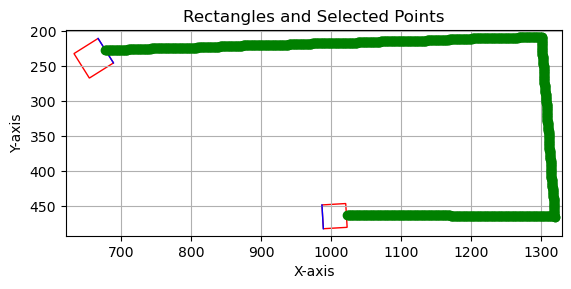

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the saved data from the .npz file
data_path = r"D:\arm_bot_numpy_files_straight_lines\straight_lines_case_3.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the selected coordinates and angles/corners of markers
selected_coordinates = data["line_coordinates"]
angles_and_corners = data["angles_and_corners"]

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates
all_x_coords = []
all_y_coords = []

# Loop through the angles and corners to plot the rectangles
for marker_data in angles_and_corners:
    corners = marker_data["corners"]
    
    # Extract the corner points
    top_left = corners["top_left"]
    top_right = corners["top_right"]
    bottom_right = corners["bottom_right"]
    bottom_left = corners["bottom_left"]
    
    # Add corner points to the lists of all x and y coordinates
    all_x_coords.extend([top_left[0], top_right[0], bottom_right[0], bottom_left[0]])
    all_y_coords.extend([top_left[1], top_right[1], bottom_right[1], bottom_left[1]])

    # Create a rectangle patch based on the corner points
    width = np.linalg.norm(np.array(top_right) - np.array(top_left))  # Distance between top_left and top_right
    height = np.linalg.norm(np.array(bottom_left) - np.array(top_left))  # Distance between top_left and bottom_left
    
    # Create a patch (rotated rectangle) using the width, height, and angle
    angle_of_rotation = marker_data["angle"]
    
    # Create the rectangle at top-left with a rotation angle
    rect = patches.Rectangle(
        top_left, width, height, angle=angle_of_rotation, 
        linewidth=1, edgecolor='r', facecolor='none'
    )
    ax.plot([top_left[0], top_right[0]], [top_left[1], top_right[1]], color='blue', linewidth=1)
    
    # Add the rectangle to the plot
    ax.add_patch(rect)

# Plot the selected coordinates
for coord in selected_coordinates:
    ax.plot(coord[0], coord[1], 'go')  # Green point for selected coordinates
    all_x_coords.append(coord[0])
    all_y_coords.append(coord[1])

# Set the plot limits based on the range of the x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()


Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_0.npz
Centroid of the first rectangle: [706.5  506.75]
Angle of the first rectangle: -136.3971710205078 degrees


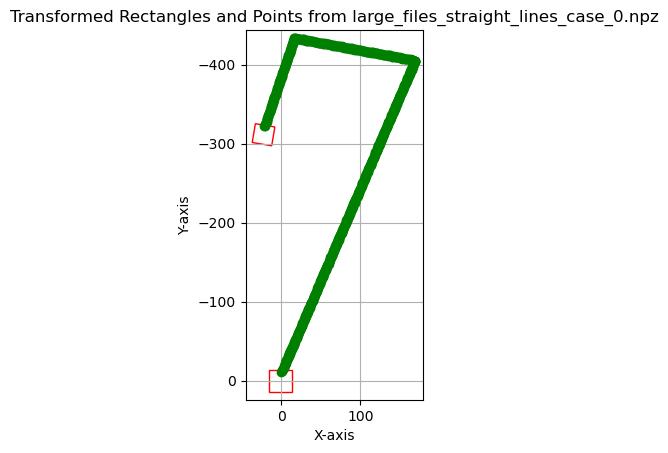

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_0.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_1.npz
Centroid of the first rectangle: [706.25 502.5 ]
Angle of the first rectangle: -137.72630310058594 degrees


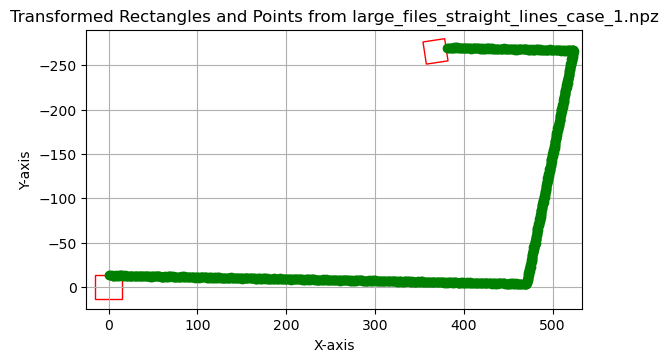

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_1.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_10.npz
Centroid of the first rectangle: [416.    95.25]
Angle of the first rectangle: -119.24882507324219 degrees


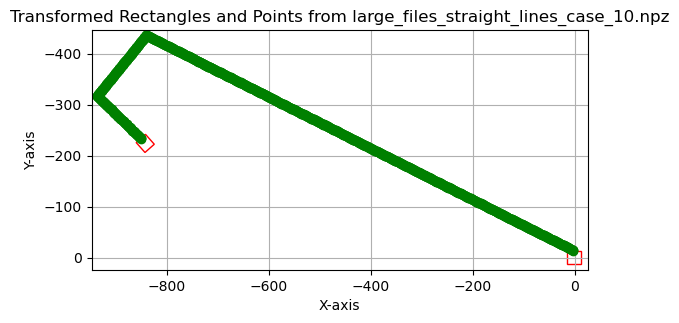

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_10.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_11.npz
Centroid of the first rectangle: [422.25 109.25]
Angle of the first rectangle: -119.24882507324219 degrees


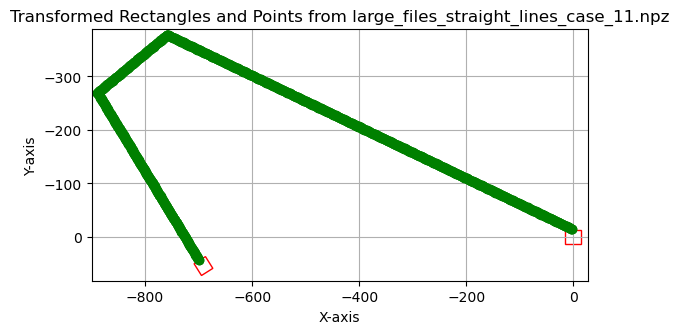

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_11.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_12.npz
Centroid of the first rectangle: [418.25 100.75]
Angle of the first rectangle: -120.96375274658203 degrees


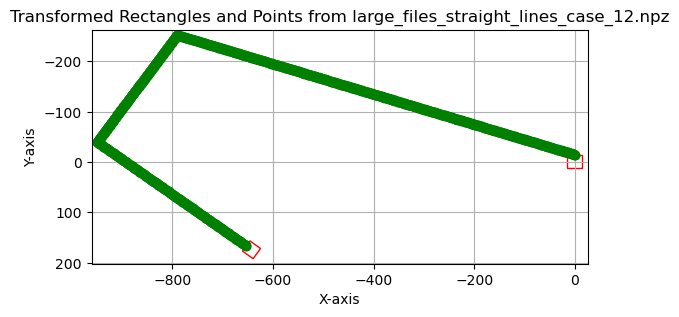

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_12.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_13.npz
Centroid of the first rectangle: [408.75 179.5 ]
Angle of the first rectangle: 177.95458984375 degrees


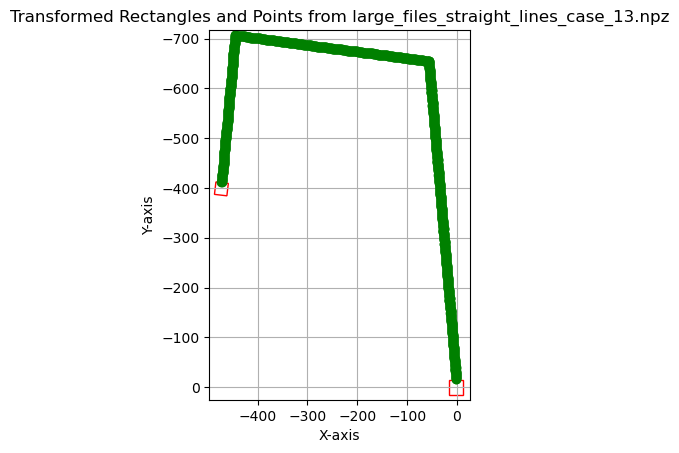

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_13.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_14.npz
Centroid of the first rectangle: [213.75 429.25]
Angle of the first rectangle: 55.175506591796875 degrees


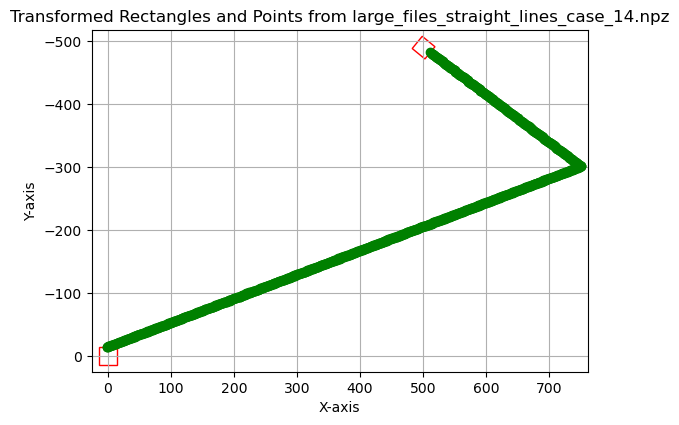

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_14.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_15.npz
Centroid of the first rectangle: [214.5 432.5]
Angle of the first rectangle: 55.175506591796875 degrees


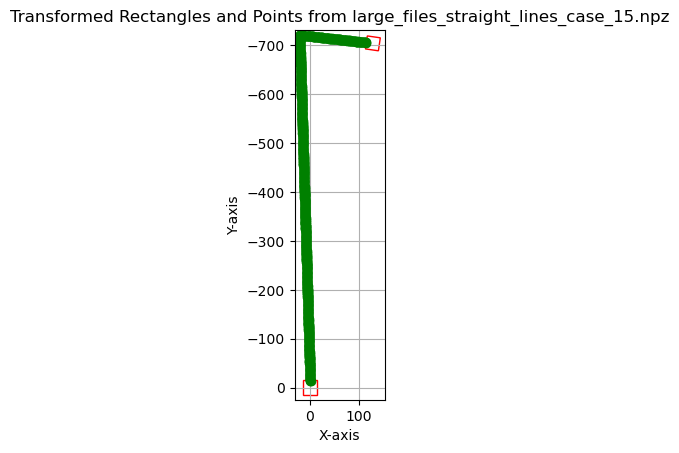

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_15.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_17.npz
Centroid of the first rectangle: [130.  257.5]
Angle of the first rectangle: 71.56504821777344 degrees


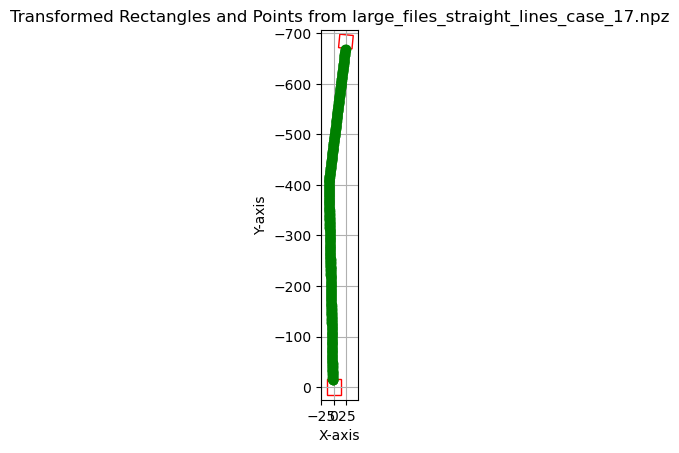

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_17.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_18.npz
Centroid of the first rectangle: [134.25 261.75]
Angle of the first rectangle: 71.56504821777344 degrees


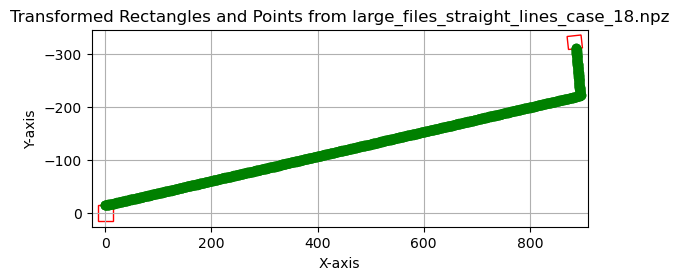

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_18.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_19.npz
Centroid of the first rectangle: [135.   262.25]
Angle of the first rectangle: 70.90650177001953 degrees


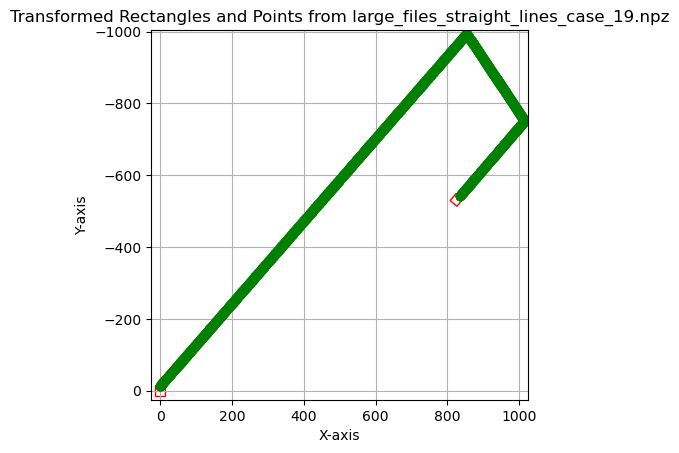

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_19.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_20.npz
Centroid of the first rectangle: [329.5  104.75]
Angle of the first rectangle: 69.6768569946289 degrees


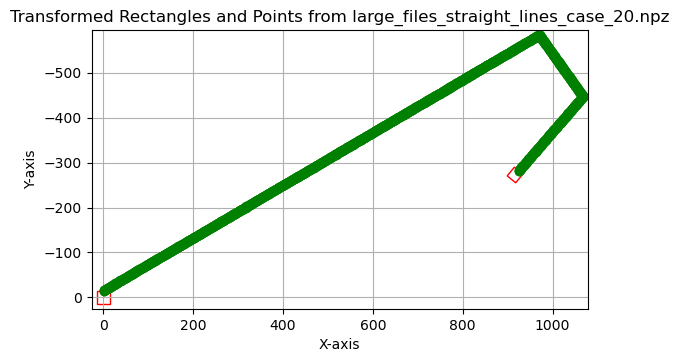

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_20.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_21.npz
Centroid of the first rectangle: [331.75  91.  ]
Angle of the first rectangle: 140.71058654785156 degrees


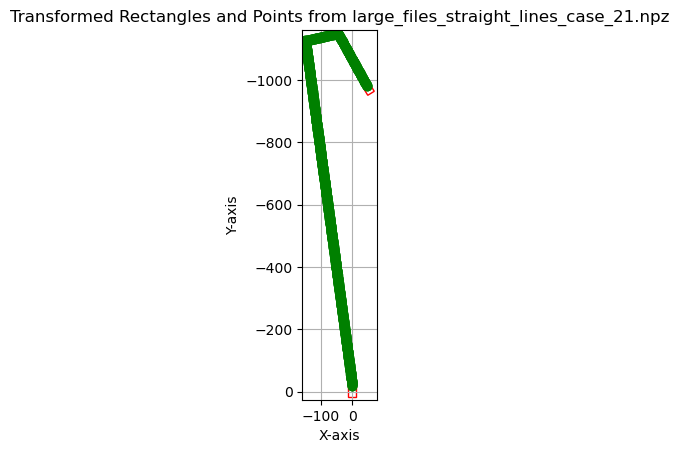

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_21.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_22.npz
Centroid of the first rectangle: [334.75  87.  ]
Angle of the first rectangle: 135.0 degrees


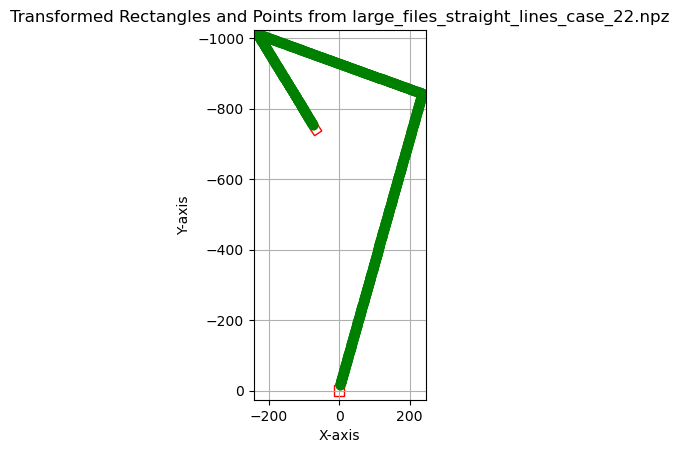

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_22.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_23.npz
Centroid of the first rectangle: [205.5 148.5]
Angle of the first rectangle: -123.6900634765625 degrees


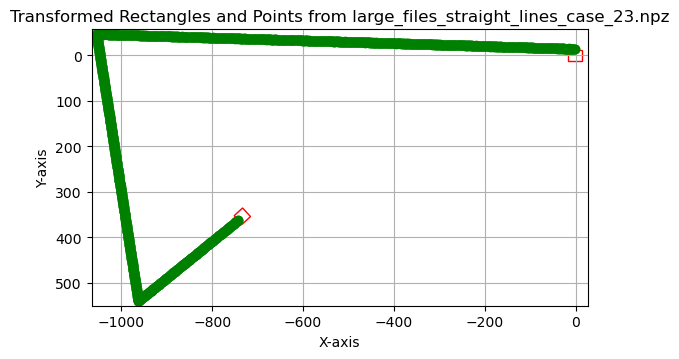

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_23.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_24.npz
Centroid of the first rectangle: [207.5  148.75]
Angle of the first rectangle: -123.6900634765625 degrees


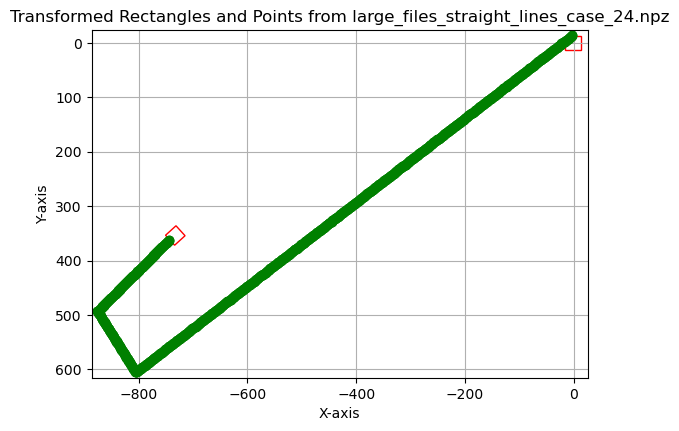

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_24.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_25.npz
Centroid of the first rectangle: [202.25 145.75]
Angle of the first rectangle: -122.00537872314453 degrees


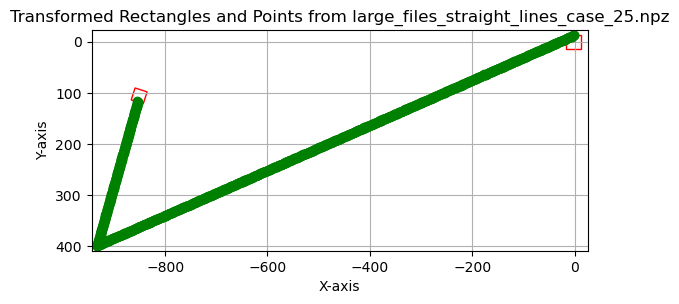

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_25.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_26.npz
Centroid of the first rectangle: [275.   152.25]
Angle of the first rectangle: -152.5255584716797 degrees


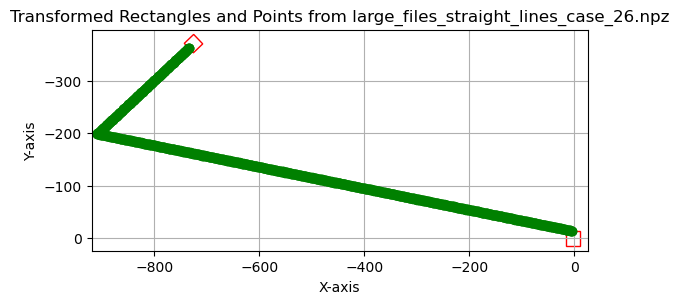

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_26.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_29.npz
Centroid of the first rectangle: [264.75 147.75]
Angle of the first rectangle: -154.35899353027344 degrees


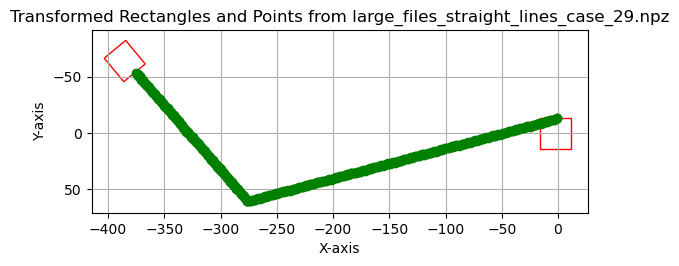

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_29.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_30.npz
Centroid of the first rectangle: [172.25 281.  ]
Angle of the first rectangle: 133.4518280029297 degrees


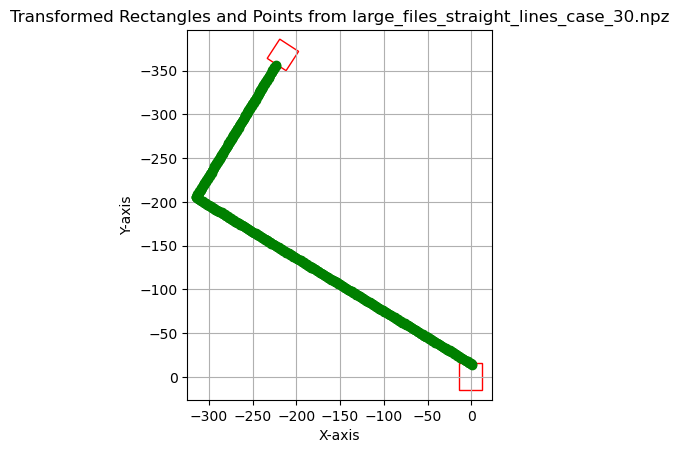

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_30.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_31.npz
Centroid of the first rectangle: [177.  279.5]
Angle of the first rectangle: 133.53118896484375 degrees


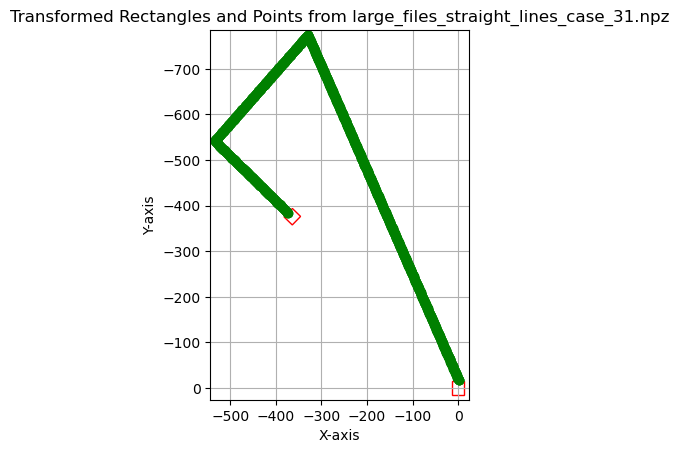

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_31.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_32.npz
Centroid of the first rectangle: [106.5  242.25]
Angle of the first rectangle: 104.5344467163086 degrees


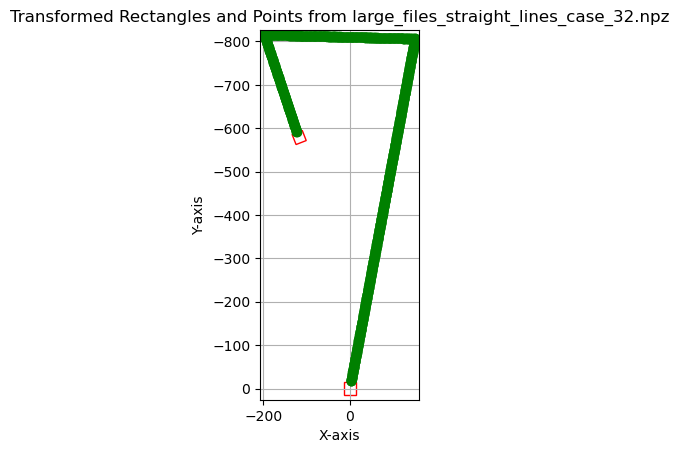

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_32.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_33.npz
Centroid of the first rectangle: [111.5 243. ]
Angle of the first rectangle: 104.5344467163086 degrees


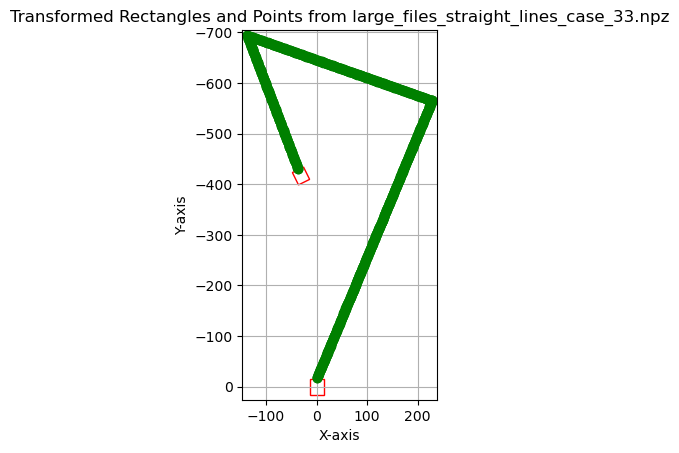

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_33.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_34.npz
Centroid of the first rectangle: [109.5 240.5]
Angle of the first rectangle: 104.03623962402344 degrees


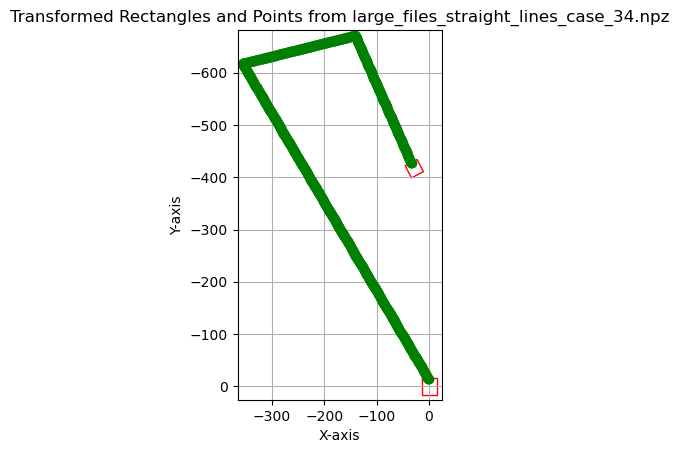

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_34.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_35.npz
Centroid of the first rectangle: [101. 239.]
Angle of the first rectangle: 104.5344467163086 degrees


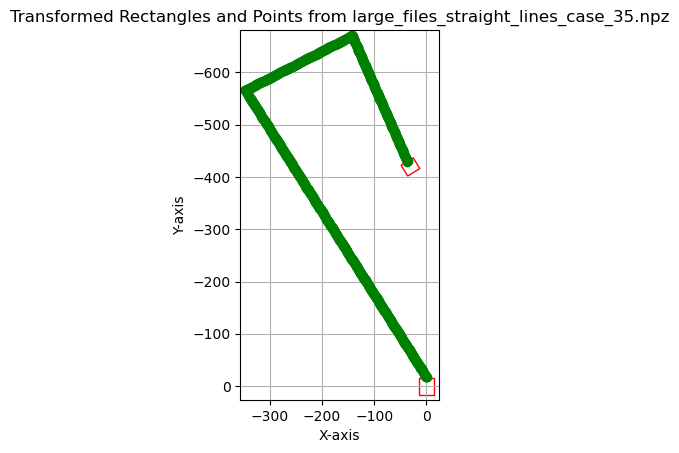

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_35.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_37.npz
Centroid of the first rectangle: [111.   246.25]
Angle of the first rectangle: 102.0947494506836 degrees


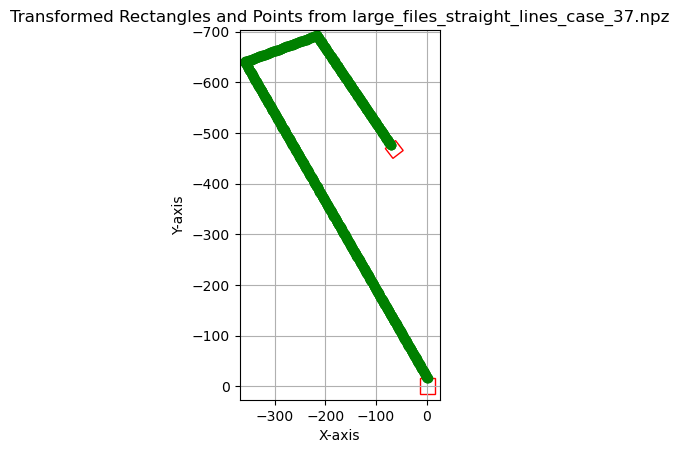

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_37.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_38.npz
Centroid of the first rectangle: [107.75 247.25]
Angle of the first rectangle: 106.50435638427734 degrees


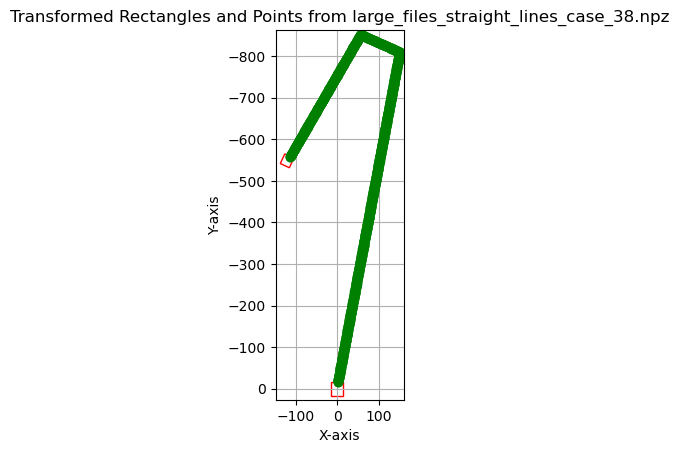

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_38.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_39.npz
Centroid of the first rectangle: [121.75 253.75]
Angle of the first rectangle: 104.5344467163086 degrees


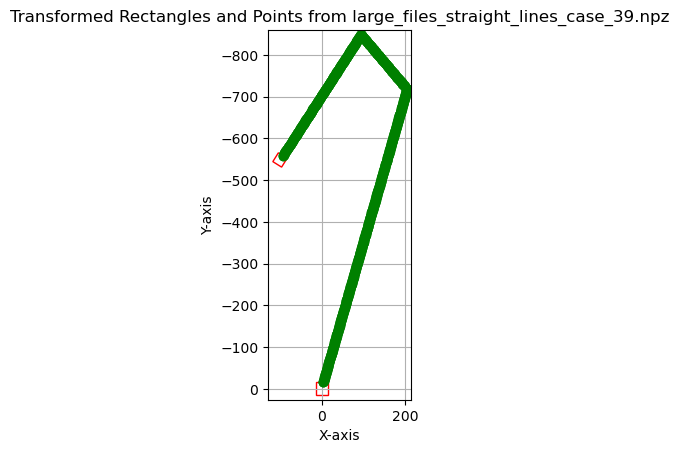

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_39.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_40.npz
Centroid of the first rectangle: [410.25 372.  ]
Angle of the first rectangle: 142.30575561523438 degrees


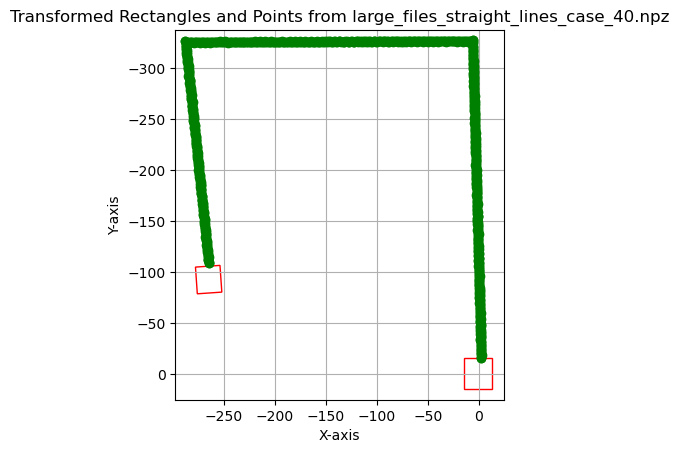

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_40.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_41.npz
Centroid of the first rectangle: [412.75 376.5 ]
Angle of the first rectangle: 141.95294189453125 degrees


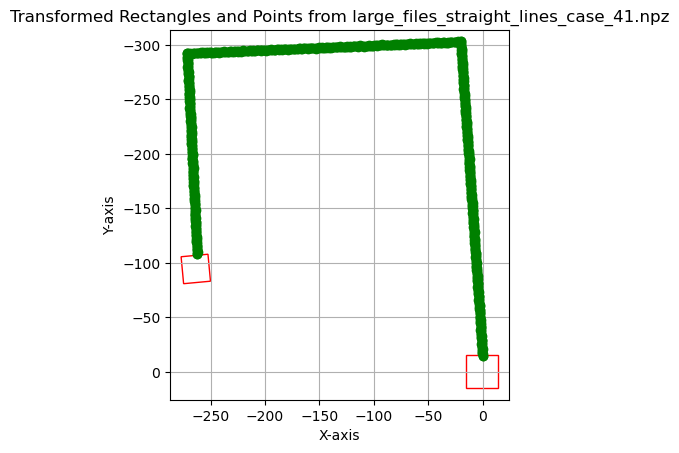

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_41.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_42.npz
Centroid of the first rectangle: [411.5 372.5]
Angle of the first rectangle: 143.97262573242188 degrees


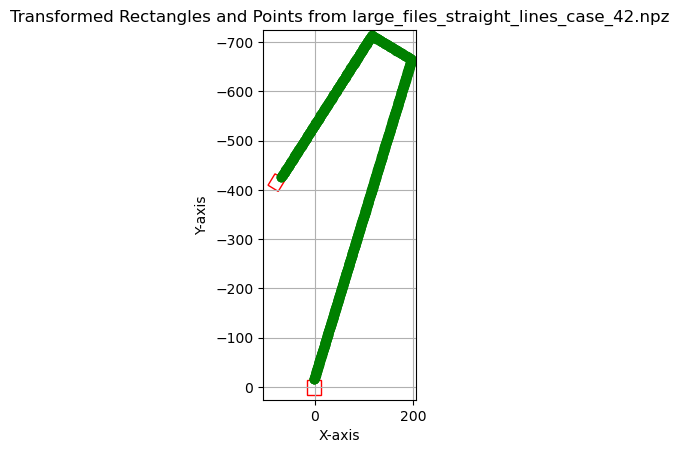

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_42.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_43.npz
Centroid of the first rectangle: [409.25 373.75]
Angle of the first rectangle: 140.71058654785156 degrees


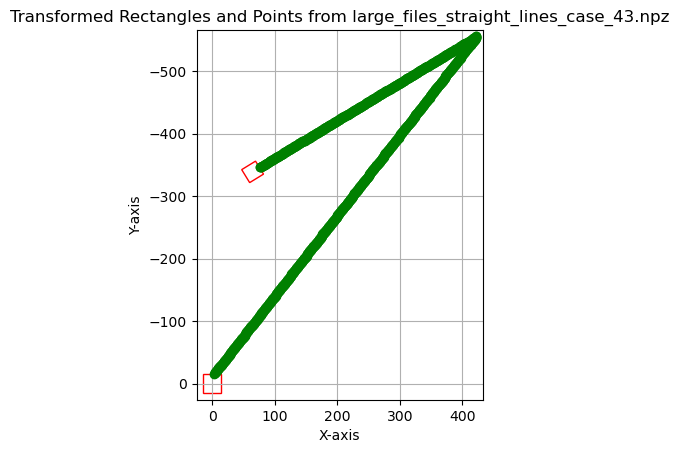

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_43.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_44.npz
Centroid of the first rectangle: [410.75 375.  ]
Angle of the first rectangle: 142.30575561523438 degrees


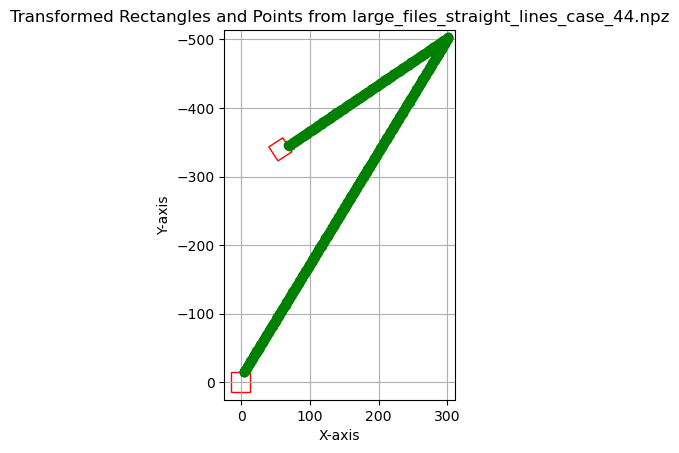

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_44.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_45.npz
Centroid of the first rectangle: [356.75 315.25]
Angle of the first rectangle: 153.43495178222656 degrees


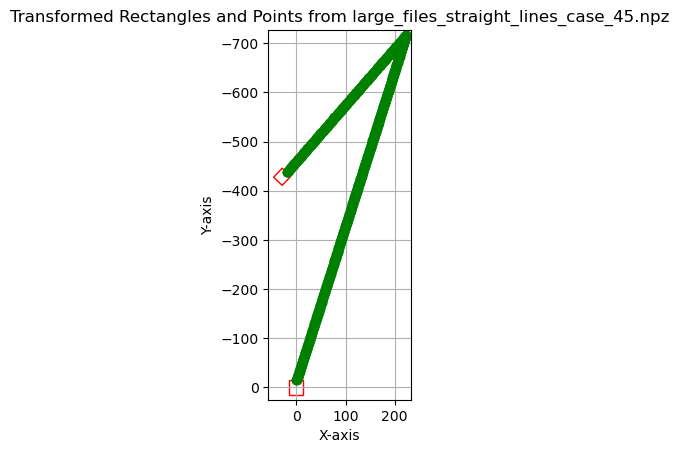

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_45.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_46.npz
Centroid of the first rectangle: [445.75 202.75]
Angle of the first rectangle: 107.81887817382812 degrees


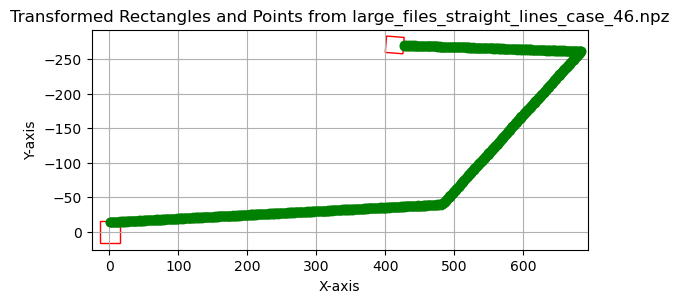

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_46.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_47.npz
Centroid of the first rectangle: [538.25 167.  ]
Angle of the first rectangle: 66.03750610351562 degrees


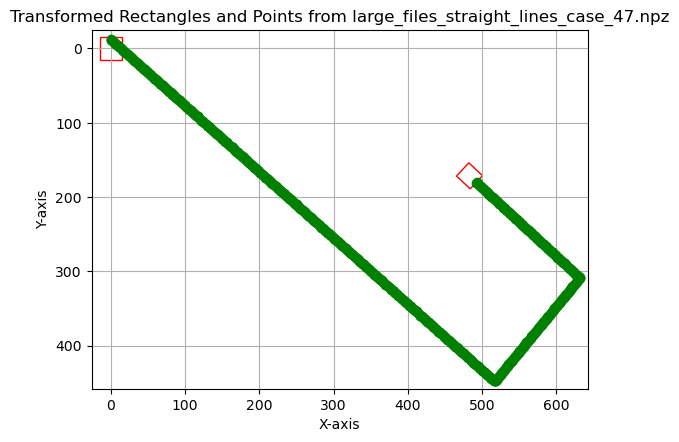

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_47.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_48.npz
Centroid of the first rectangle: [536.5  165.25]
Angle of the first rectangle: 65.09523010253906 degrees


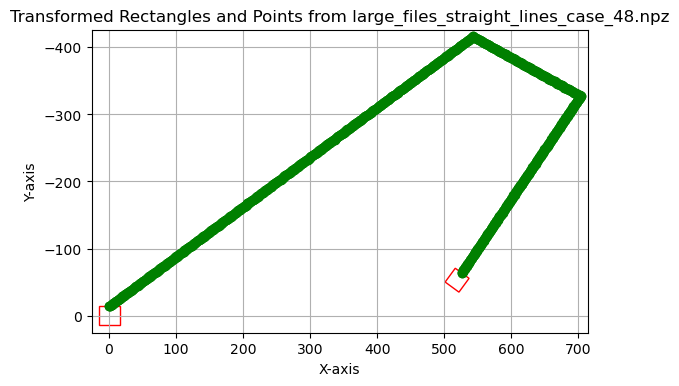

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_48.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_49.npz
Centroid of the first rectangle: [539.75 167.5 ]
Angle of the first rectangle: 64.2900390625 degrees


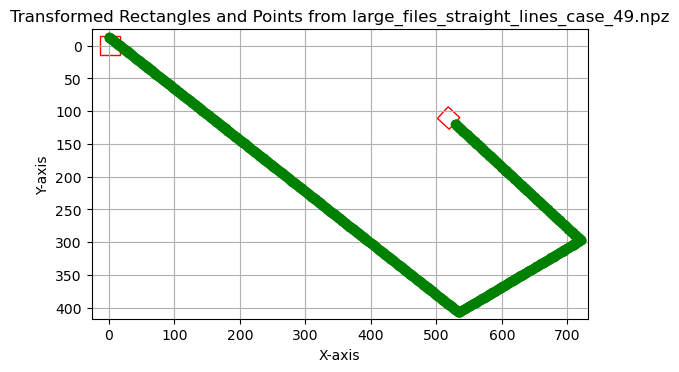

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_49.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_5.npz
Centroid of the first rectangle: [703.75 496.5 ]
Angle of the first rectangle: -135.0 degrees


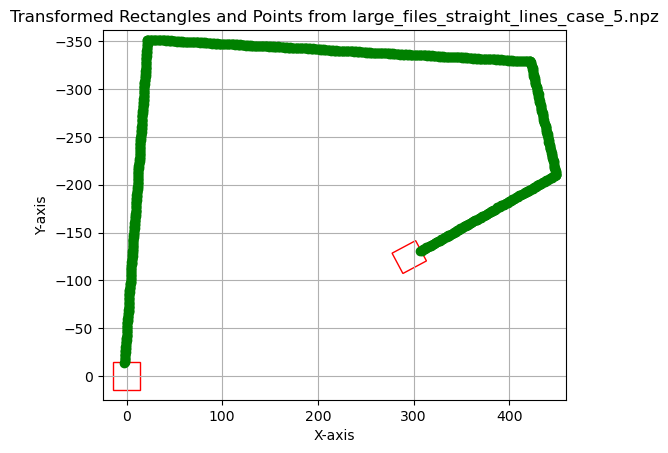

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_5.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_50.npz
Centroid of the first rectangle: [535.75 167.  ]
Angle of the first rectangle: 64.2900390625 degrees


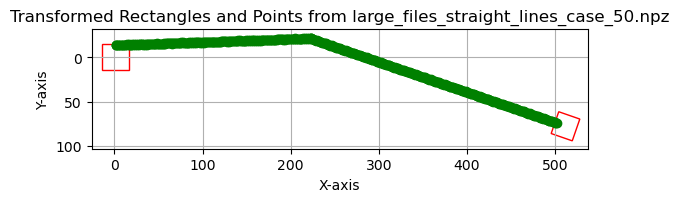

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_50.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_51.npz
Centroid of the first rectangle: [319.   141.75]
Angle of the first rectangle: -133.53118896484375 degrees


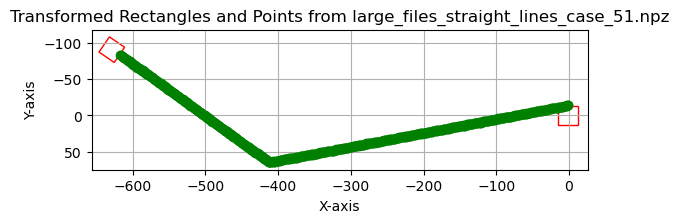

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_51.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_52.npz
Centroid of the first rectangle: [623.   110.75]
Angle of the first rectangle: -113.96248626708984 degrees


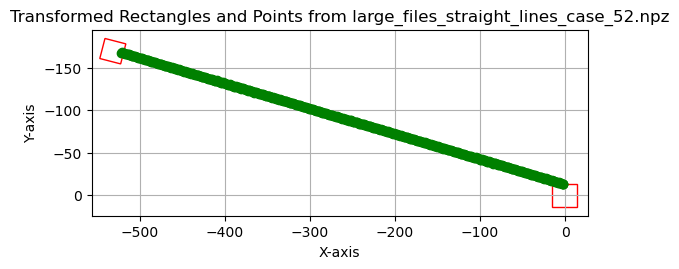

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_52.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_6.npz
Centroid of the first rectangle: [708.5 501. ]
Angle of the first rectangle: -136.3971710205078 degrees


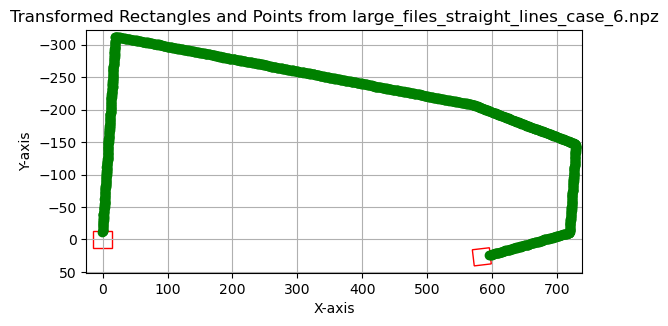

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_6.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_7.npz
Centroid of the first rectangle: [443.   110.25]
Angle of the first rectangle: 177.87889099121094 degrees


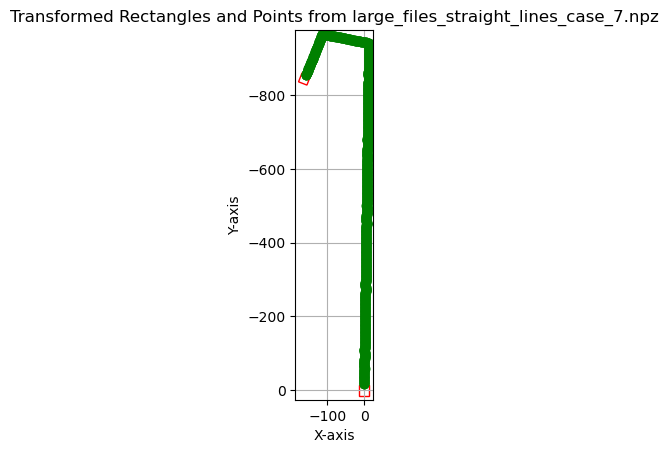

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_7.npz
Processing file: D:\arm_bot_large_files_straight_lines\large_files_straight_lines_case_8.npz
Centroid of the first rectangle: [264.5 200.5]
Angle of the first rectangle: 123.6900634765625 degrees


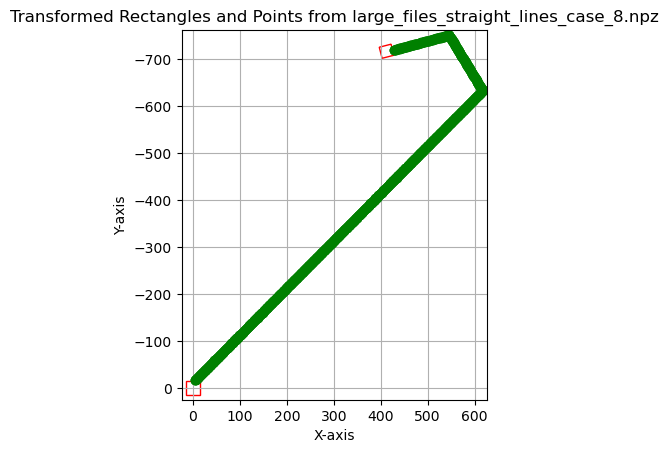

Transformed data saved to D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_8.npz


In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define the input and output folders
input_folder = r"D:\arm_bot_large_files_straight_lines"
output_folder = r"D:\arm_bot_large_files_transformed"

# Ensure the output folder exists
os.makedirs(output_folder, exist_ok=True)

# Loop through each file in the input folder
for file_name in os.listdir(input_folder):
    if file_name.endswith(".npz"):
        file_path = os.path.join(input_folder, file_name)
        print(f"Processing file: {file_path}")
        
        # Load the saved data from the .npz file
        data = np.load(file_path, allow_pickle=True)

        # Extract the selected coordinates and angles/corners of markers
        selected_coordinates = data["line_coordinates"]
        angles_and_corners = data["angles_and_corners"]

        # Initialize the plot (Optional: Remove if visualization is not needed)
        fig, ax = plt.subplots()

        # Initialize lists to store all x and y coordinates
        all_x_coords = []
        all_y_coords = []

        # Initialize lists to store transformed rectangles and points
        transformed_rectangles = []
        transformed_points = []

        # Calculate the centroid of the first rectangle (for shifting)
        first_marker_data = angles_and_corners[0]
        first_corners = first_marker_data["corners"]

        # Compute the centroid of the first rectangle
        top_left = np.array(first_corners["top_left"])
        top_right = np.array(first_corners["top_right"])
        bottom_right = np.array(first_corners["bottom_right"])
        bottom_left = np.array(first_corners["bottom_left"])

        centroid_x = (top_left[0] + top_right[0] + bottom_right[0] + bottom_left[0]) / 4
        centroid_y = (top_left[1] + top_right[1] + bottom_right[1] + bottom_left[1]) / 4
        centroid = np.array([centroid_x, centroid_y])

        print(f"Centroid of the first rectangle: {centroid}")

        # Get the rotation angle of the first rectangle
        first_angle = first_marker_data["angle"]
        print(f"Angle of the first rectangle: {first_angle} degrees")

        # Convert the angle to radians for the rotation matrix
        theta = np.radians(-first_angle)

        # Rotation matrix for counter-clockwise rotation
        rotation_matrix = np.array([
            [np.cos(theta), -np.sin(theta)],
            [np.sin(theta), np.cos(theta)]
        ])

        # Function to shift and rotate coordinates
        def shift_and_rotate(coord, centroid, rotation_matrix):
            shifted_coord = coord - centroid  # Shift to centroid
            rotated_coord = np.dot(rotation_matrix, shifted_coord)  # Apply rotation
            return rotated_coord

        # Loop through the angles and corners to plot the rectangles with shifted and rotated coordinates
        angles_and_corners_r = []
        for marker_data in angles_and_corners:
            corners = marker_data["corners"]
            marker_id = marker_data["marker_id"]

            # Extract and shift the corner points
            top_left_shifted = shift_and_rotate(np.array(corners["top_left"]), centroid, rotation_matrix)
            top_right_shifted = shift_and_rotate(np.array(corners["top_right"]), centroid, rotation_matrix)
            bottom_right_shifted = shift_and_rotate(np.array(corners["bottom_right"]), centroid, rotation_matrix)
            bottom_left_shifted = shift_and_rotate(np.array(corners["bottom_left"]), centroid, rotation_matrix)

            # Add shifted and rotated corner points to the lists of all x and y coordinates
            all_x_coords.extend([top_left_shifted[0], top_right_shifted[0], bottom_right_shifted[0], bottom_left_shifted[0]])
            all_y_coords.extend([top_left_shifted[1], top_right_shifted[1], bottom_right_shifted[1], bottom_left_shifted[1]])

            # Store the transformed rectangle coordinates
            transformed_rectangles.append({
                "top_left": top_left_shifted,
                "top_right": top_right_shifted,
                "bottom_right": bottom_right_shifted,
                "bottom_left": bottom_left_shifted
            })

            # Create a rectangle patch based on the shifted and rotated corner points
            width = np.linalg.norm(top_right_shifted - top_left_shifted)  # Distance between top_left and top_right
            height = np.linalg.norm(bottom_left_shifted - top_left_shifted)  # Distance between top_left and bottom_left
            delta_y = top_right_shifted[1] - top_left_shifted[1]
            delta_x = top_right_shifted[0] - top_left_shifted[0]
            angle = np.degrees(np.arctan2(delta_y, delta_x))

            # Add the rectangle to the plot (Optional)
            rect = patches.Rectangle(
                top_left_shifted, width, height, angle=angle, 
                linewidth=1, edgecolor='r', facecolor='none'
            )
            ax.add_patch(rect)
            
            # Store the transformed marker data
            centroid_x_r = (top_left_shifted[0] + top_right_shifted[0] + bottom_right_shifted[0] + bottom_left_shifted[0]) / 4
            centroid_y_r = (top_left_shifted[1] + top_right_shifted[1] + bottom_right_shifted[1] + bottom_left_shifted[1]) / 4
            centroid_r = np.array([centroid_x_r, centroid_y_r])
            
            marker_data_r = {
                "marker_id": marker_id,
                "angle": angle,
                "corners": {
                    "top_left": tuple(top_left_shifted),
                    "top_right": tuple(top_right_shifted),
                    "bottom_right": tuple(bottom_right_shifted),
                    "bottom_left": tuple(bottom_left_shifted)
                },
                "centroid": centroid_r
            }
            angles_and_corners_r.append(marker_data_r)

        # Plot the selected coordinates with the same shift and rotation applied (Optional)
        for coord in selected_coordinates:
            coord_shifted_rotated = shift_and_rotate(np.array(coord), centroid, rotation_matrix)
            ax.plot(coord_shifted_rotated[0], coord_shifted_rotated[1], 'go')  # Green point for selected coordinates
            all_x_coords.append(coord_shifted_rotated[0])
            all_y_coords.append(coord_shifted_rotated[1])

            # Store the transformed points
            transformed_points.append(coord_shifted_rotated)

        # Set the plot limits based on the range of the shifted and rotated x and y coordinates
        x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
        y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
        ax.set_aspect('equal')

        # Show the plot (Optional: Remove if visualization is not needed)
        plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
        plt.title(f"Transformed Rectangles and Points from {file_name}")
        plt.xlabel("X-axis")
        plt.ylabel("Y-axis")
        plt.grid(True)
        plt.show()

        coordinates = np.array(transformed_points)

        # Downsample coordinates if needed (Optional)
        target_points = 500
        total_points = coordinates.shape[0]
        indices = np.linspace(0, total_points - 1, target_points, dtype=int)
        downsampled_coordinates = coordinates[indices]

        # Save the transformed data in a new .npz file in the output folder
        save_file_name = f"transformed_{file_name}"
        save_file_path = os.path.join(output_folder, save_file_name)
        np.savez(save_file_path, transformed_angles_and_corners=angles_and_corners_r, transformed_line_coordinates_points=downsampled_coordinates)

        print(f"Transformed data saved to {save_file_path}")


Centroid of the first rectangle: [1120.25  426.25]
Angle of the first rectangle: 1.3322198390960693 degrees


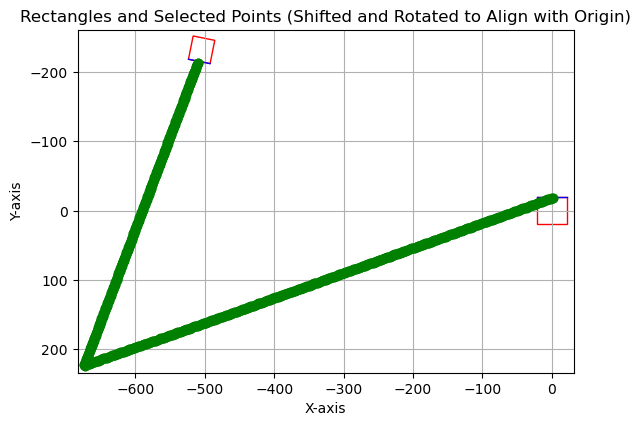

Transformed data saved to D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8.npz


In [30]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the saved data from the .npz file
data_path = r"D:\arm_bot_numpy_files_straight_lines\straight_lines_case_8.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the selected coordinates and angles/corners of markers
selected_coordinates = data["line_coordinates"]
angles_and_corners = data["angles_and_corners"]

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates
all_x_coords = []
all_y_coords = []

# Initialize lists to store transformed rectangles and points
transformed_rectangles = []
transformed_points = []

# Calculate the centroid of the first rectangle (for shifting)
first_marker_data = angles_and_corners[0]
first_corners = first_marker_data["corners"]

# Compute the centroid of the first rectangle
top_left = np.array(first_corners["top_left"])
top_right = np.array(first_corners["top_right"])
bottom_right = np.array(first_corners["bottom_right"])
bottom_left = np.array(first_corners["bottom_left"])

centroid_x = (top_left[0] + top_right[0] + bottom_right[0] + bottom_left[0]) / 4
centroid_y = (top_left[1] + top_right[1] + bottom_right[1] + bottom_left[1]) / 4
centroid = np.array([centroid_x, centroid_y])

print(f"Centroid of the first rectangle: {centroid}")

# Get the rotation angle of the first rectangle
first_angle = first_marker_data["angle"]
print(f"Angle of the first rectangle: {first_angle} degrees")

# Convert the angle to radians for the rotation matrix
theta = np.radians(-first_angle)

# Rotation matrix for counter-clockwise rotation
rotation_matrix = np.array([
    [np.cos(theta), -np.sin(theta)],
    [np.sin(theta), np.cos(theta)]
])

# Function to shift and rotate coordinates
def shift_and_rotate(coord, centroid, rotation_matrix):
    shifted_coord = coord - centroid  # Shift to centroid
    rotated_coord = np.dot(rotation_matrix, shifted_coord)  # Apply rotation
    return rotated_coord

# Loop through the angles and corners to plot the rectangles with shifted and rotated coordinates
angles_and_corners_r=[]
for marker_data in angles_and_corners:
    corners = marker_data["corners"]
    marker_id=marker_data["marker_id"]
    
    # Extract and shift the corner points
    top_left_shifted = shift_and_rotate(np.array(corners["top_left"]), centroid, rotation_matrix)
    top_right_shifted = shift_and_rotate(np.array(corners["top_right"]), centroid, rotation_matrix)
    bottom_right_shifted = shift_and_rotate(np.array(corners["bottom_right"]), centroid, rotation_matrix)
    bottom_left_shifted = shift_and_rotate(np.array(corners["bottom_left"]), centroid, rotation_matrix)
    
    # Add shifted and rotated corner points to the lists of all x and y coordinates
    all_x_coords.extend([top_left_shifted[0], top_right_shifted[0], bottom_right_shifted[0], bottom_left_shifted[0]])
    all_y_coords.extend([top_left_shifted[1], top_right_shifted[1], bottom_right_shifted[1], bottom_left_shifted[1]])

    # Store the transformed rectangle coordinates
    transformed_rectangles.append({
        "top_left": top_left_shifted,
        "top_right": top_right_shifted,
        "bottom_right": bottom_right_shifted,
        "bottom_left": bottom_left_shifted
    })

    # Create a rectangle patch based on the shifted and rotated corner points
    width = np.linalg.norm(top_right_shifted - top_left_shifted)  # Distance between top_left and top_right
    height = np.linalg.norm(bottom_left_shifted - top_left_shifted)  # Distance between top_left and bottom_left
    delta_y = top_right_shifted[1] - top_left_shifted[1]
    delta_x = top_right_shifted[0] - top_left_shifted[0]
    angle = np.degrees(np.arctan2(delta_y, delta_x))
    # Create the rectangle at the shifted and rotated top-left (rotation is now 0)
    rect = patches.Rectangle(
        top_left_shifted, width, height, angle=angle, 
        linewidth=1, edgecolor='r', facecolor='none'
    )
    ax.plot([top_left_shifted[0], top_right_shifted[0]], [top_left_shifted[1], top_right_shifted[1]], color='blue', linewidth=1)
    centroid_x_r = (top_left_shifted[0] + top_right_shifted[0] + bottom_right_shifted[0] + bottom_left_shifted[0]) / 4
    centroid_y_r = (top_left_shifted[1] + top_right_shifted[1] + bottom_right_shifted[1] + bottom_left_shifted[1]) / 4
    centroid_r = np.array([centroid_x_r, centroid_y_r])
    
    # Add the rectangle to the plot
    ax.add_patch(rect)
    marker_data_r = {
            "marker_id": marker_id,
            "angle": angle,
            "corners": {
                "top_left": tuple(top_left_shifted),
                "top_right": tuple(top_right_shifted),
                "bottom_right": tuple(bottom_right_shifted),
                "bottom_left": tuple(bottom_left_shifted)
            },
            "centroid": centroid_r
        }
    angles_and_corners_r.append(marker_data_r)

# Plot the selected coordinates with the same shift and rotation applied
for coord in selected_coordinates:
    coord_shifted_rotated = shift_and_rotate(np.array(coord), centroid, rotation_matrix)
    ax.plot(coord_shifted_rotated[0], coord_shifted_rotated[1], 'go')  # Green point for selected coordinates
    all_x_coords.append(coord_shifted_rotated[0])
    all_y_coords.append(coord_shifted_rotated[1])
    
    # Store the transformed points
    transformed_points.append(coord_shifted_rotated)

# Set the plot limits based on the range of the shifted and rotated x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points (Shifted and Rotated to Align with Origin)")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()
coordinates = np.array(transformed_points)

# Number of points you want to downsample to
target_points = 500

# Calculate the indices to sample based on total number of points
total_points = coordinates.shape[0]
indices = np.linspace(0, total_points - 1, target_points, dtype=int)

# Downsample the array
downsampled_coordinates = coordinates[indices]
# Save the transformed data in a new .npz file
save_path = r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8.npz"
np.savez(save_path, transformed_angles_and_corners=angles_and_corners_r, transformed_line_coordinates_points=downsampled_coordinates)

print(f"Transformed data saved to {save_path}")


Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_0.npz


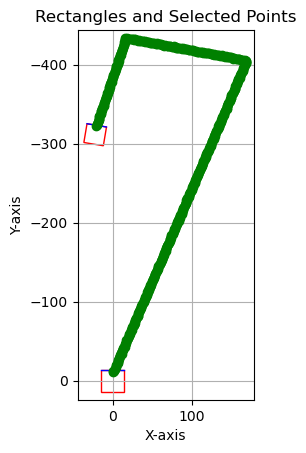

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_0.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_1.npz


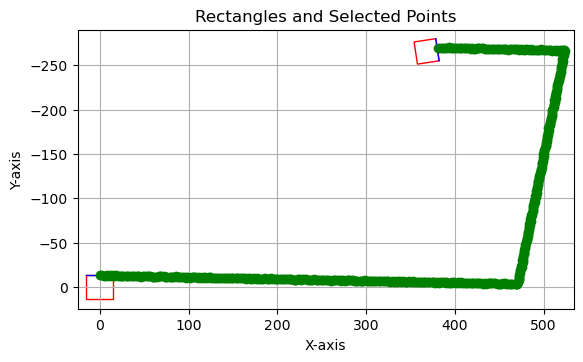

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_1.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_10.npz


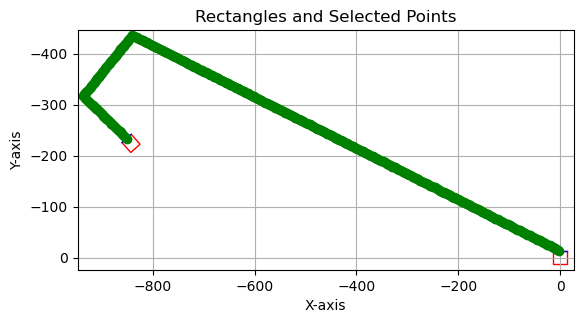

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_10.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_11.npz


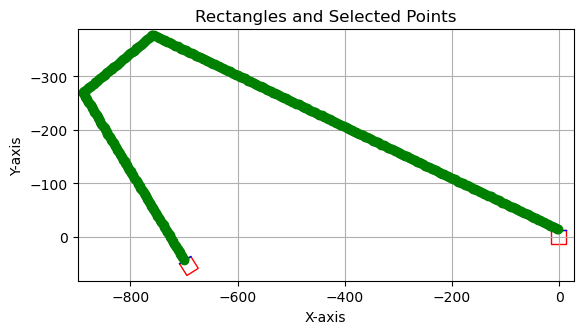

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_11.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_12.npz


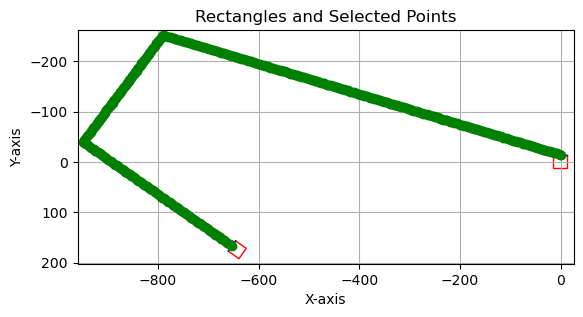

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_12.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_13.npz


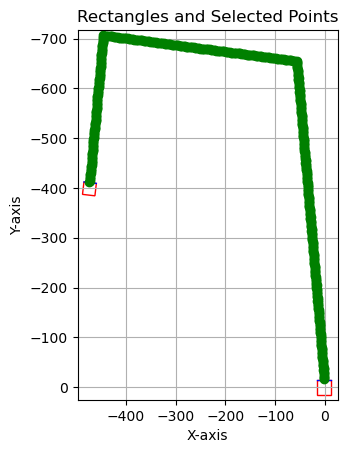

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_13.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_14.npz


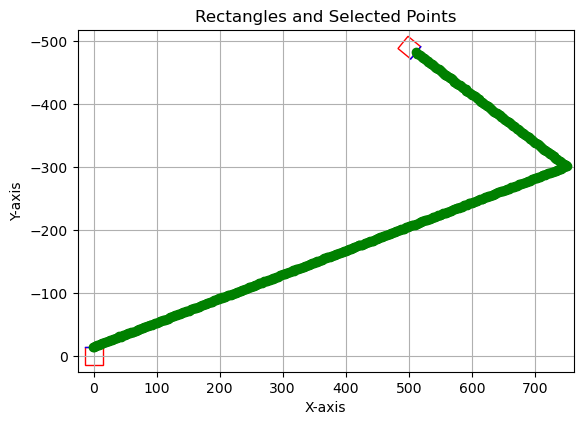

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_14.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_15.npz


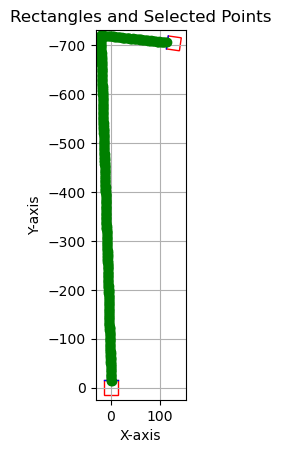

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_15.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_17.npz


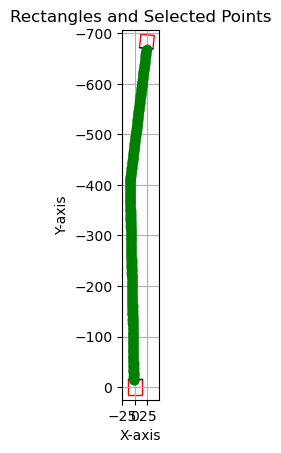

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_17.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_18.npz


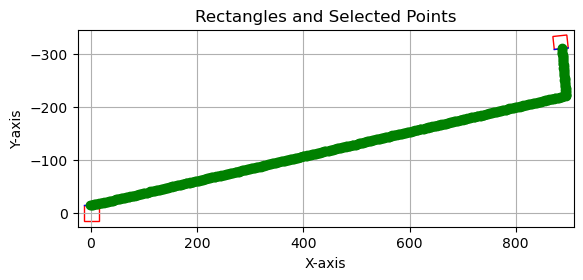

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_18.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_19.npz


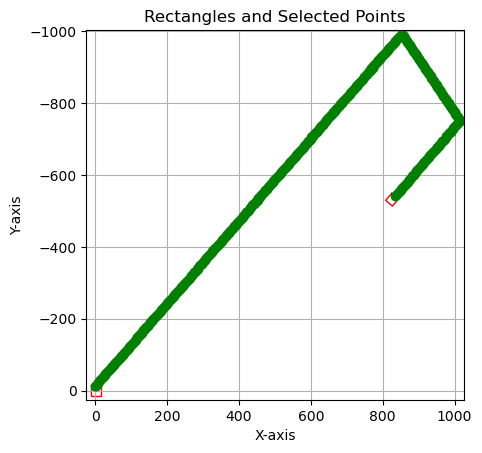

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_19.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_20.npz


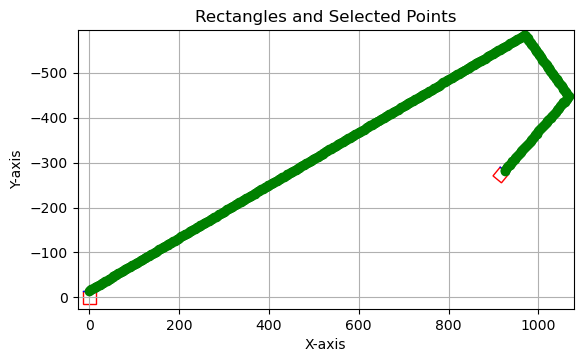

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_20.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_21.npz


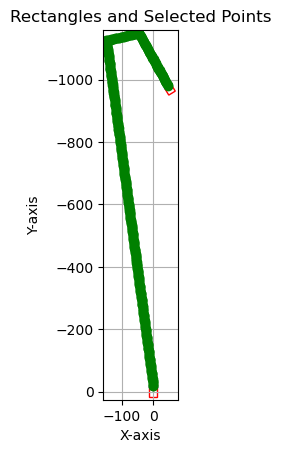

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_21.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_22.npz


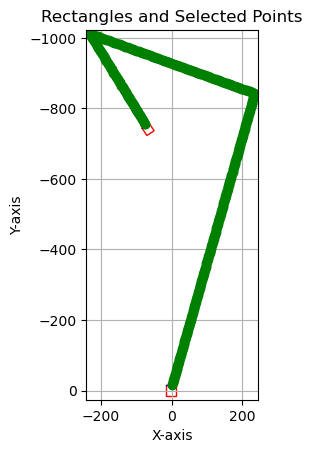

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_22.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_23.npz


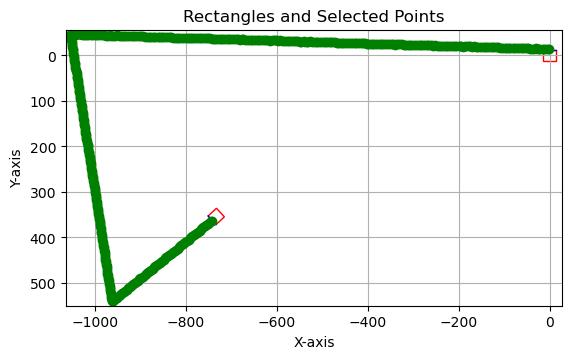

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_23.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_24.npz


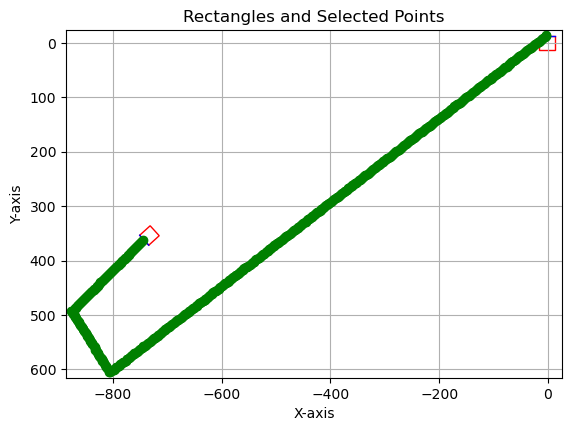

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_24.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_25.npz


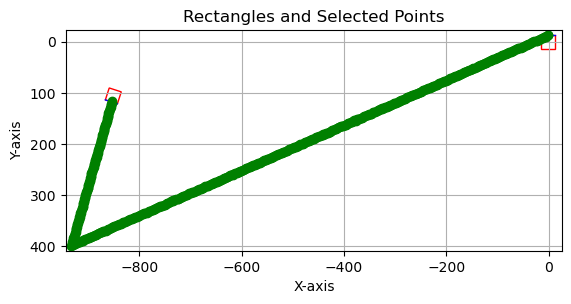

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_25.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_26.npz


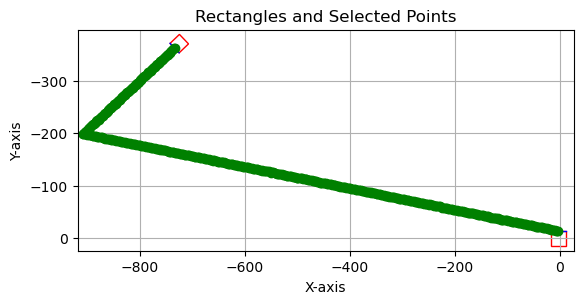

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_26.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_29.npz


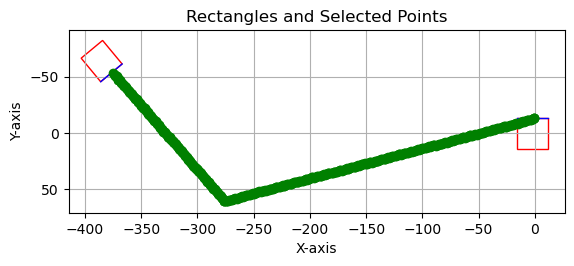

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_29.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_30.npz


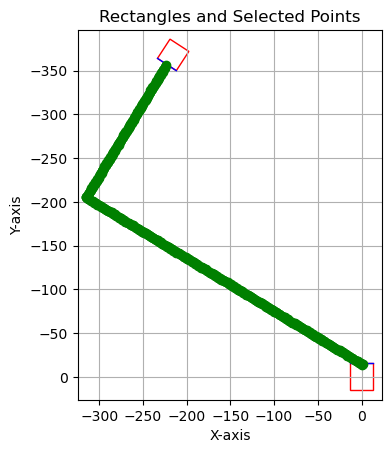

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_30.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_31.npz


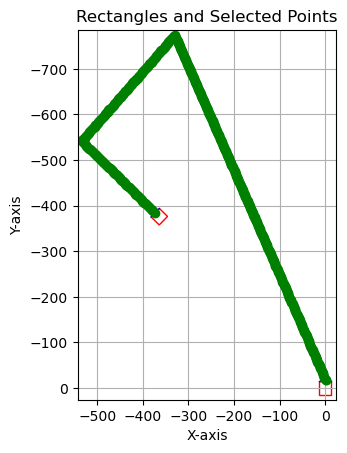

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_31.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_32.npz


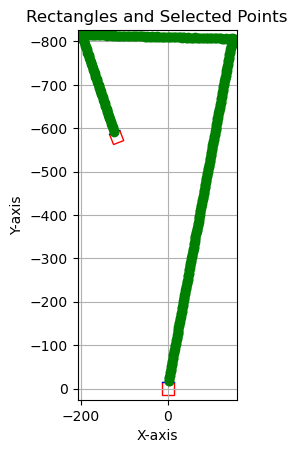

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_32.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_33.npz


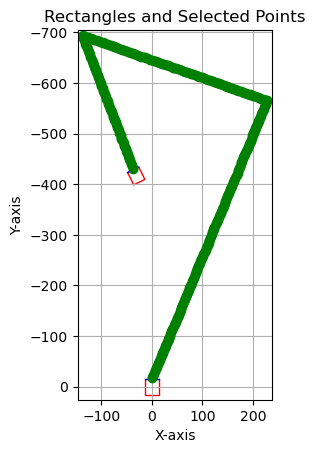

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_33.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_34.npz


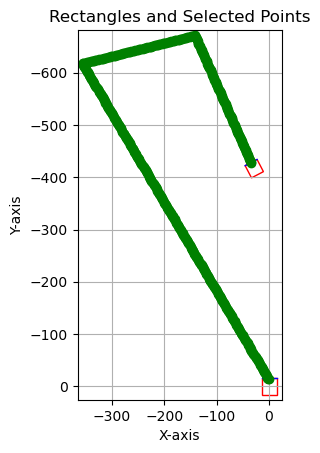

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_34.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_35.npz


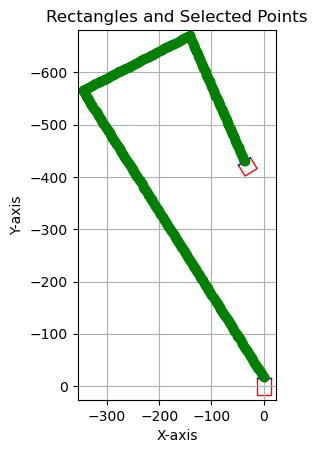

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_35.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_37.npz


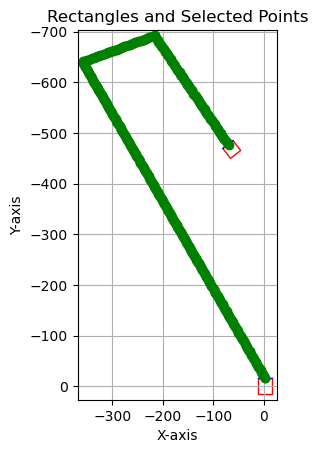

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_37.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_38.npz


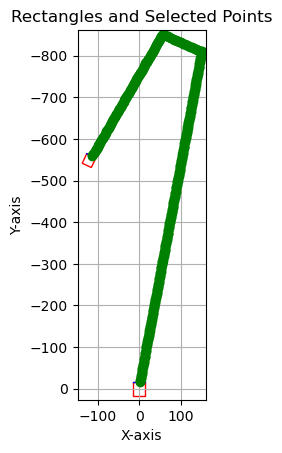

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_38.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_39.npz


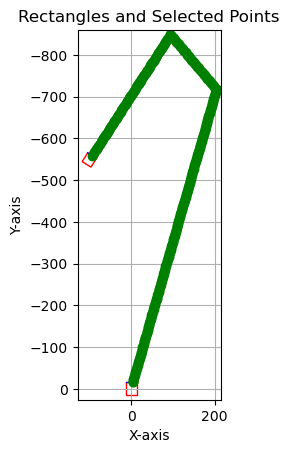

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_39.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_40.npz


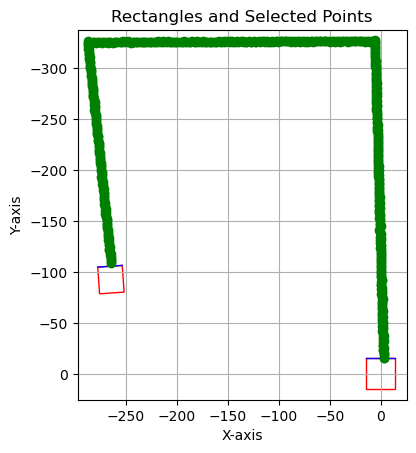

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_40.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_41.npz


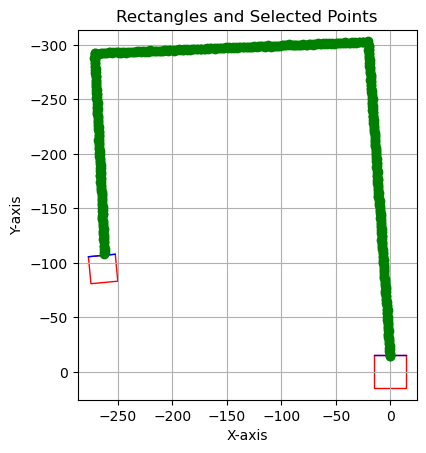

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_41.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_42.npz


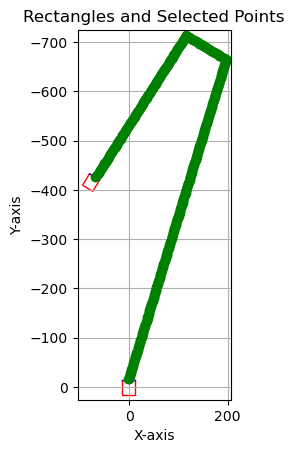

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_42.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_43.npz


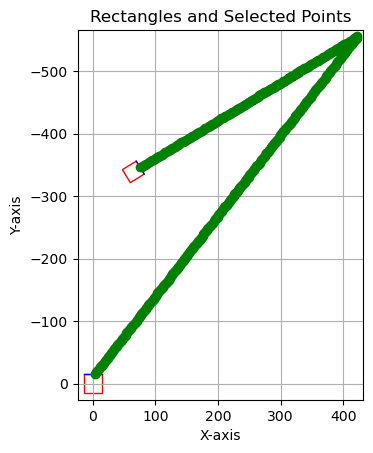

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_43.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_44.npz


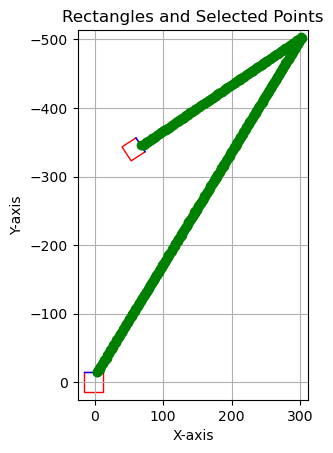

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_44.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_45.npz


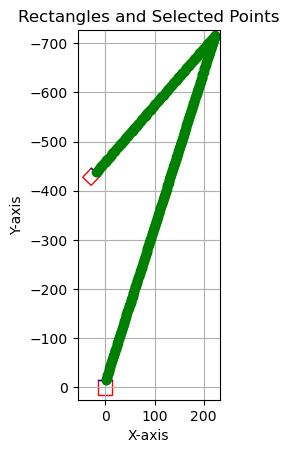

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_45.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_46.npz


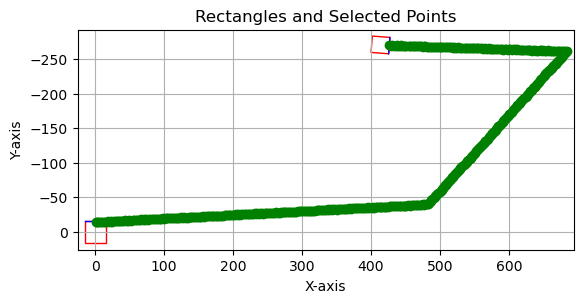

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_46.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_47.npz


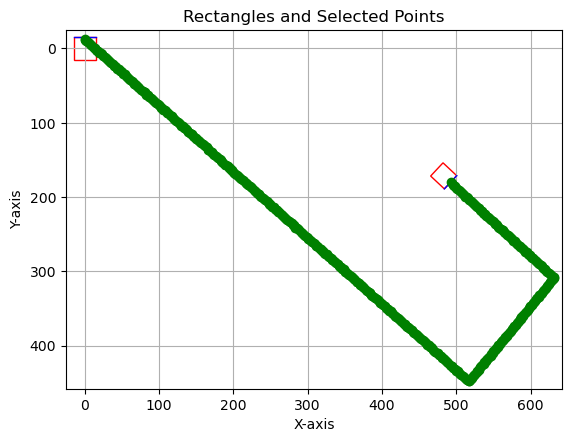

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_47.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_48.npz


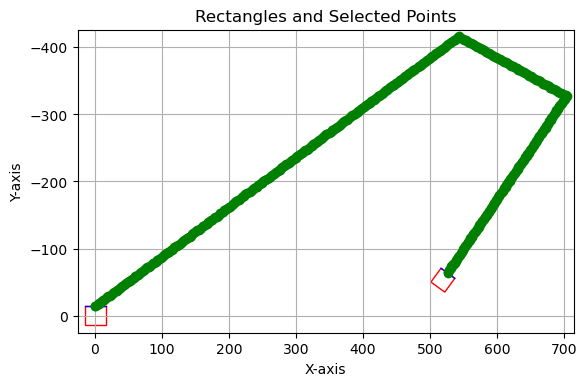

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_48.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_49.npz


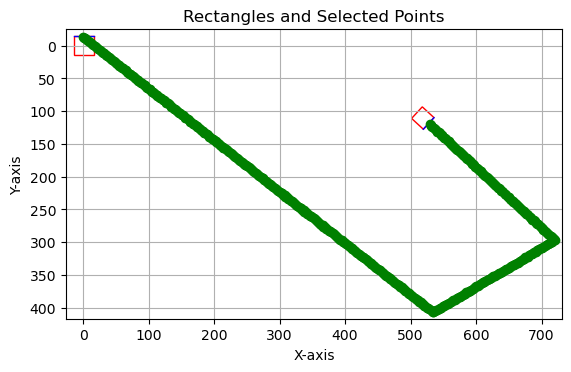

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_49.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_5.npz


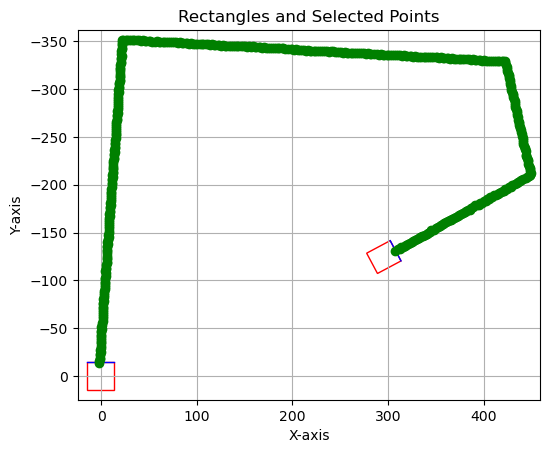

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_5.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_50.npz


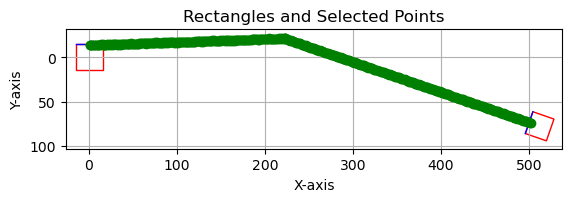

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_50.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_51.npz


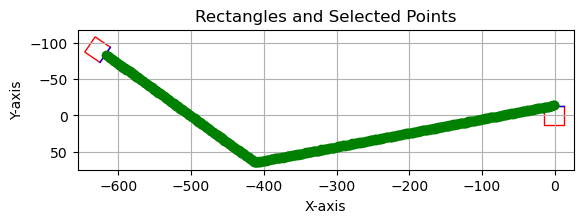

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_51.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_52.npz


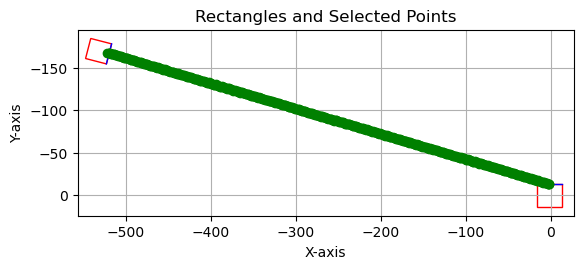

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_52.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_6.npz


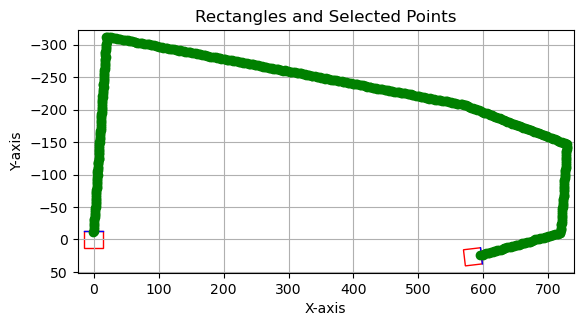

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_6.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_7.npz


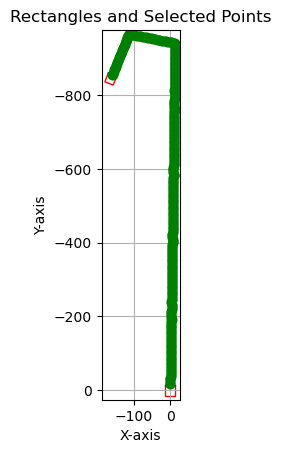

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_7.npz
Processing file: D:\arm_bot_large_files_transformed\transformed_large_files_straight_lines_case_8.npz


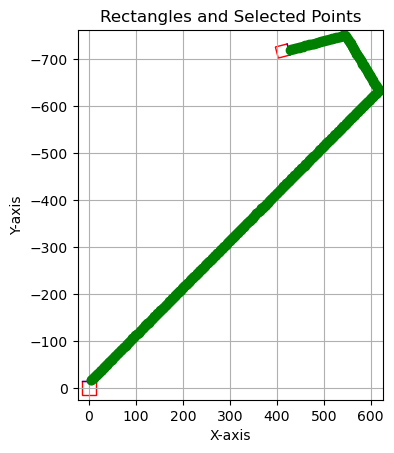

Processed data saved to D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_8.npz


In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Function to process and transform the data for each .npz file
def process_file(file_path, output_folder):
    # Load the saved data from the .npz file
    data = np.load(file_path, allow_pickle=True)

    # Extract the selected coordinates and angles/corners of markers
    selected_coordinates = data["transformed_line_coordinates_points"]
    angles_and_corners = data["transformed_angles_and_corners"]

    # Generate new time column for selected coordinates
    new_column = np.arange(0.001, 0.001 * (len(selected_coordinates) + 1), 0.001).reshape(-1, 1)

    # Concatenate the original array with the new column
    selected_coordinates_time = np.hstack((selected_coordinates, new_column))

    # Initialize the plot
    fig, ax = plt.subplots()

    # Initialize lists to store all x and y coordinates
    all_x_coords = []
    all_y_coords = []

    # Loop through the angles and corners to plot the rectangles
    for marker_data in angles_and_corners:
        corners = marker_data["corners"]
        
        # Extract the corner points
        top_left = corners["top_left"]
        top_right = corners["top_right"]
        bottom_right = corners["bottom_right"]
        bottom_left = corners["bottom_left"]
        
        # Add corner points to the lists of all x and y coordinates
        all_x_coords.extend([top_left[0], top_right[0], bottom_right[0], bottom_left[0]])
        all_y_coords.extend([top_left[1], top_right[1], bottom_right[1], bottom_left[1]])

        # Create a rectangle patch based on the corner points
        width = np.linalg.norm(np.array(top_right) - np.array(top_left))  # Distance between top_left and top_right
        height = np.linalg.norm(np.array(bottom_left) - np.array(top_left))  # Distance between top_left and bottom_left
        
        # Create a patch (rotated rectangle) using the width, height, and angle
        angle_of_rotation = marker_data["angle"]
        
        # Create the rectangle at top-left with a rotation angle
        rect = patches.Rectangle(
            top_left, width, height, angle=angle_of_rotation, 
            linewidth=1, edgecolor='r', facecolor='none'
        )
        ax.plot([top_left[0], top_right[0]], [top_left[1], top_right[1]], color='blue', linewidth=1)
        
        # Add the rectangle to the plot
        ax.add_patch(rect)

    # Plot the selected coordinates
    for coord in selected_coordinates:
        ax.plot(coord[0], coord[1], 'go')  # Green point for selected coordinates
        all_x_coords.append(coord[0])
        all_y_coords.append(coord[1])

    # Set the plot limits based on the range of the x and y coordinates
    x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
    y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    ax.set_aspect('equal')

    # Invert y-axis to match image coordinates
    plt.gca().invert_yaxis()
    plt.title("Rectangles and Selected Points")
    plt.xlabel("X-axis")
    plt.ylabel("Y-axis")
    plt.grid(True)
    
    # Show plot (optional, can be removed for batch processing)
    plt.show()

    # Create the output file path based on the original file name
    filename = os.path.basename(file_path)
    save_path = os.path.join(output_folder, filename)

    # Save the processed data in the output folder
    np.savez(save_path, transformed_angles_and_corners=angles_and_corners, transformed_line_coordinates_points=selected_coordinates_time)
    print(f"Processed data saved to {save_path}")

# Function to process all files in the input folder and save to the output folder
def process_folder(input_folder, output_folder):
    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)
    
    # Loop through all .npz files in the input folder
    for file_name in os.listdir(input_folder):
        if file_name.endswith(".npz"):  # Only process .npz files
            file_path = os.path.join(input_folder, file_name)
            print(f"Processing file: {file_path}")
            process_file(file_path, output_folder)

# Example usage
input_folder = r"D:\arm_bot_large_files_transformed"  # Path to your input folder containing .npz files
output_folder = r"D:\arm_bot_large_files_transformed_processed"  # Path to save the processed files

process_folder(input_folder, output_folder)


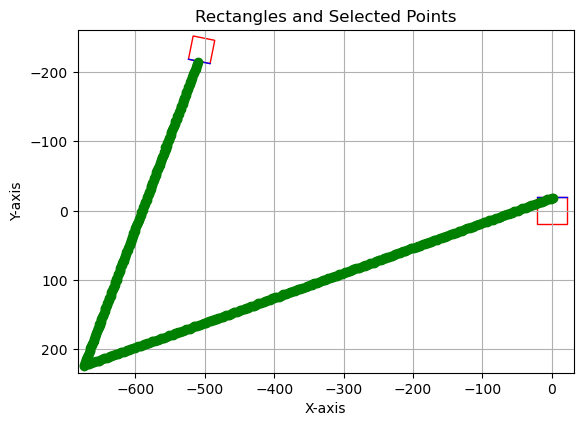

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the saved data from the .npz file
data_path = r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the selected coordinates and angles/corners of markers
selected_coordinates = data["transformed_line_coordinates_points"]
angles_and_corners = data["transformed_angles_and_corners"]

new_column = np.arange(0.001, 0.001 * (len(selected_coordinates) + 1), 0.001).reshape(-1, 1)

# Concatenate the original array with the new column
selected_coordinates_time= np.hstack((selected_coordinates, new_column))

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates
all_x_coords = []
all_y_coords = []

# Loop through the angles and corners to plot the rectangles
for marker_data in angles_and_corners:
    corners = marker_data["corners"]
    
    # Extract the corner points
    top_left = corners["top_left"]
    top_right = corners["top_right"]
    bottom_right = corners["bottom_right"]
    bottom_left = corners["bottom_left"]
    
    # Add corner points to the lists of all x and y coordinates
    all_x_coords.extend([top_left[0], top_right[0], bottom_right[0], bottom_left[0]])
    all_y_coords.extend([top_left[1], top_right[1], bottom_right[1], bottom_left[1]])

    # Create a rectangle patch based on the corner points
    width = np.linalg.norm(np.array(top_right) - np.array(top_left))  # Distance between top_left and top_right
    height = np.linalg.norm(np.array(bottom_left) - np.array(top_left))  # Distance between top_left and bottom_left
    
    # Create a patch (rotated rectangle) using the width, height, and angle
    angle_of_rotation = marker_data["angle"]
    
    # Create the rectangle at top-left with a rotation angle
    rect = patches.Rectangle(
        top_left, width, height, angle=angle_of_rotation, 
        linewidth=1, edgecolor='r', facecolor='none'
    )
    ax.plot([top_left[0], top_right[0]], [top_left[1], top_right[1]], color='blue', linewidth=1)
    
    # Add the rectangle to the plot
    ax.add_patch(rect)

# Plot the selected coordinates
for coord in selected_coordinates:
    ax.plot(coord[0], coord[1], 'go')  # Green point for selected coordinates
    all_x_coords.append(coord[0])
    all_y_coords.append(coord[1])

# Set the plot limits based on the range of the x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')
save_path = r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8_time.npz"
np.savez(save_path, transformed_angles_and_corners=angles_and_corners, transformed_line_coordinates_points=selected_coordinates_time)

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()


In [3]:
import os
import numpy as np
import scipy.io

# Function to convert a single .npz file to a .mat file
def convert_npz_to_mat(npz_file_path, output_folder):
    # Load the .npz file
    data = np.load(npz_file_path, allow_pickle=True)

    # Extract the arrays from the .npz file
    transformed_line_coordinates_points = data["transformed_line_coordinates_points"]
    transformed_angles_and_corners = data["transformed_angles_and_corners"]

    # Prepare a dictionary for saving
    mat_data = {
        'transformed_curve_points_time': transformed_line_coordinates_points,
        'transformed_angles_and_corners': transformed_angles_and_corners
    }

    # Create the output file path with .mat extension
    filename = os.path.basename(npz_file_path).replace(".npz", ".mat")
    mat_file_path = os.path.join(output_folder, filename)

    # Save to a .mat file
    scipy.io.savemat(mat_file_path, mat_data)

    print(f"Converted and saved {filename} to {output_folder}")

# Function to process all .npz files in the input folder
def process_folder(input_folder, output_folder):
    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)

    # Loop through all .npz files in the input folder
    for file_name in os.listdir(input_folder):
        if file_name.endswith(".npz"):  # Only process .npz files
            npz_file_path = os.path.join(input_folder, file_name)
            print(f"Processing file: {npz_file_path}")
            convert_npz_to_mat(npz_file_path, output_folder)

# Example usage
input_folder = r"D:\arm_bot_large_files_transformed_processed"  # Path to your input folder containing .npz files
output_folder = r"D:\arm_bot_large_files_transformed_processed_mat"  # Path to save the converted .mat files

# Process the folder
process_folder(input_folder, output_folder)


Processing file: D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_0.npz
Converted and saved transformed_large_files_straight_lines_case_0.mat to D:\arm_bot_large_files_transformed_processed_mat
Processing file: D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_1.npz
Converted and saved transformed_large_files_straight_lines_case_1.mat to D:\arm_bot_large_files_transformed_processed_mat
Processing file: D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_10.npz
Converted and saved transformed_large_files_straight_lines_case_10.mat to D:\arm_bot_large_files_transformed_processed_mat
Processing file: D:\arm_bot_large_files_transformed_processed\transformed_large_files_straight_lines_case_11.npz
Converted and saved transformed_large_files_straight_lines_case_11.mat to D:\arm_bot_large_files_transformed_processed_mat
Processing file: D:\arm_bot_large_files_transformed_processe

In [45]:
import numpy as np
import scipy.io

# Load the .npz file
data_path = r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8_time.npz"
data = np.load(data_path, allow_pickle=True)

# Extract the arrays from the .npz file
transformed_line_coordinates_points = data["transformed_line_coordinates_points"]
transformed_angles_and_corners = data["transformed_angles_and_corners"]

# Prepare a dictionary to save
mat_data = {
    'transformed_curve_points_time':transformed_line_coordinates_points,
    'transformed_angles_and_corners': transformed_angles_and_corners
}

# Save to a .mat file
scipy.io.savemat( r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8_time.mat", mat_data)

print("Conversion to .mat file completed!")

Conversion to .mat file completed!


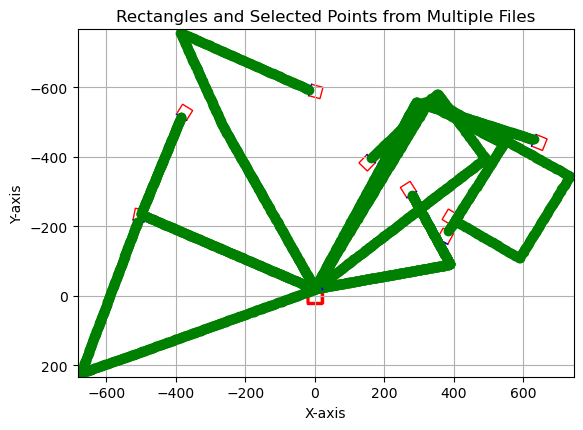

In [37]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os

# List of .npz file paths
file_paths = [
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_1_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_2_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_3_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_4_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_5_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_6_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_7_time.npz",
    r"D:\arm_bot_numpy_files_straight_lines\transformed_straight_lines_case_8_time.npz"
    # Add more file paths as needed
]

# Initialize the plot
fig, ax = plt.subplots()

# Initialize lists to store all x and y coordinates from all files
all_x_coords = []
all_y_coords = []

# Loop through each .npz file
for file_path in file_paths:
    if os.path.exists(file_path):
        # Load the saved data from the .npz file
        data = np.load(file_path, allow_pickle=True)

        # Extract the selected coordinates and angles/corners of markers
        selected_coordinates = data["transformed_line_coordinates_points"]
        angles_and_corners = data["transformed_angles_and_corners"]

        # Plot rectangles and selected coordinates for each file
        for marker_data in angles_and_corners:
            corners = marker_data["corners"]

            # Extract the corner points
            top_left = corners["top_left"]
            top_right = corners["top_right"]
            bottom_right = corners["bottom_right"]
            bottom_left = corners["bottom_left"]

            # Add corner points to the lists of all x and y coordinates
            all_x_coords.extend([top_left[0], top_right[0], bottom_right[0], bottom_left[0]])
            all_y_coords.extend([top_left[1], top_right[1], bottom_right[1], bottom_left[1]])

            # Create a rectangle patch based on the corner points
            width = np.linalg.norm(np.array(top_right) - np.array(top_left))  # Distance between top_left and top_right
            height = np.linalg.norm(np.array(bottom_left) - np.array(top_left))  # Distance between top_left and bottom_left

            # Create a patch (rotated rectangle) using the width, height, and angle
            angle_of_rotation = marker_data["angle"]

            # Create the rectangle at top-left with a rotation angle
            rect = patches.Rectangle(
                top_left, width, height, angle=angle_of_rotation, 
                linewidth=1, edgecolor='r', facecolor='none'
            )
            ax.plot([top_left[0], top_right[0]], [top_left[1], top_right[1]], color='blue', linewidth=1)

            # Add the rectangle to the plot
            ax.add_patch(rect)

        # Plot the selected coordinates
        for coord in selected_coordinates:
            ax.plot(coord[0], coord[1], 'go')  # Green point for selected coordinates
            all_x_coords.append(coord[0])
            all_y_coords.append(coord[1])
    else:
        print(f"File {file_path} not found.")

# Set the plot limits based on the range of all the x and y coordinates
x_min, x_max = min(all_x_coords) - 10, max(all_x_coords) + 10  # Add some padding
y_min, y_max = min(all_y_coords) - 10, max(all_y_coords) + 10  # Add some padding

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')

# Show the plot
plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
plt.title("Rectangles and Selected Points from Multiple Files")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.grid(True)
plt.show()


In [2]:
import cv2
from cv2 import aruco
import numpy as np
import os

# Load calibration data
calib_data_path = r"D:\calib_data_phone\MultiMatrix.npz"
calib_data = np.load(calib_data_path)
cam_mat = calib_data["camMatrix"]
dist_coef = calib_data["distCoef"]
r_vector = calib_data["rVector"]
t_Vector = calib_data["tVector"]

marker_dict = aruco.getPredefinedDictionary(aruco.DICT_6X6_250)
MARKER_SIZE = 4.5

# Create a folder to save images
save_folder = r"D:\webcam_saved_images"
if not os.path.exists(save_folder):
    os.makedirs(save_folder)

url="https://10.0.55.61:8080/video"
# Start webcam capture (0 for default webcam, change if you have multiple webcams)
cap = cv2.VideoCapture(url)

image_counter = 0

while True:
    ret, frame = cap.read()
    oui=frame.copy()

    if not ret:
        print("Error: Unable to capture video from webcam.")
        break

    gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    image_height, image_width, _ = frame.shape  # Get image dimensions

    # Detect ArUco markers
    marker_corners, marker_IDs, reject = aruco.detectMarkers(gray_image, marker_dict)

    if marker_corners:
        # Estimate pose of markers
        rVec, tVec, _ = aruco.estimatePoseSingleMarkers(marker_corners, MARKER_SIZE, cam_mat, dist_coef)
        total_markers = range(0, marker_IDs.size)
        for corners, marker_id, i in zip(marker_corners, marker_IDs, total_markers):
            # Reshape corners to a 4x2 array
            corners = corners.reshape(4, 2)

            # Get the individual corner points
            top_left = corners[0]
            top_right = corners[1]
            bottom_right = corners[2]
            bottom_left = corners[3]

            # 1. Calculate centroid of the marker (mean of the corners)
            centroid_x = int(np.mean(corners[:, 0]))
            centroid_y = int(np.mean(corners[:, 1]))
            centroid = (centroid_x, centroid_y)


            # Draw centroid on the image
            cv2.circle(frame, centroid, 1, (0, 0, 255), -1)

            # 2. Calculate the angle of rotation using the top edge (top-left to top-right)
            delta_y = top_right[1] - top_left[1]
            delta_x = top_right[0] - top_left[0]
            angle = np.degrees(np.arctan2(delta_y, delta_x))

            # Display the angle on the image
            cv2.putText(frame, f"Angle: {int(angle)}", (int(top_right[0]), int(top_right[1] - 10)),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

            print(f"Marker ID: {marker_id[0]}, Centroid: {centroid}, Angle of Rotation: {angle:.2f} degrees")

            # Draw marker outline and axes
            cv2.polylines(frame, [corners.astype(np.int32)], True, (0, 255, 255), 1, cv2.LINE_AA)
            # cv2.drawFrameAxes(frame, cam_mat, dist_coef, rVec[i], tVec[i], 4, 4)

    # Display the frame with detected markers
    #cv2.imshow("Aruco Marker Detection with Angle and Centroid", frame)
    origi_frame=frame.copy()
    frame_display=frame.copy()
    screen_res=1280,720
    height,width=frame.shape[:2]
    scale=min(screen_res[0]/width,screen_res[1]/height)
    dim=(int(width*scale),int(height*scale))
    frame_resized=cv2.resize(frame_display,dim,interpolation=cv2.INTER_AREA)

    cv2.namedWindow("Image",cv2.WINDOW_NORMAL)
    cv2.resizeWindow("Image",dim[0],dim[1])

    cv2.imshow("Image",origi_frame)
    key = cv2.waitKey(1) & 0xFF
    if key == ord('s'):
                # Save the current frame
                image_path = os.path.join(save_folder, f"saved_image_{image_counter}.jpg")
                cv2.imwrite(image_path, oui)
                print(f"Image saved: {image_path}")
                image_counter += 1
    elif key == ord('q'):
                # Exit the loop when 'q' is pressed
                print("Exiting...")
                break

    # Check for key press


# Release the webcam and close windows
cap.release()
cv2.destroyAllWindows()


Marker ID: 100, Centroid: (681, 97), Angle of Rotation: -109.65 degrees
Marker ID: 80, Centroid: (537, 144), Angle of Rotation: 177.61 degrees
Marker ID: 100, Centroid: (681, 97), Angle of Rotation: -109.65 degrees
Marker ID: 80, Centroid: (537, 143), Angle of Rotation: 175.60 degrees
Marker ID: 100, Centroid: (680, 96), Angle of Rotation: -109.65 degrees
Marker ID: 80, Centroid: (536, 143), Angle of Rotation: 177.71 degrees
Marker ID: 100, Centroid: (680, 96), Angle of Rotation: -109.03 degrees
Marker ID: 80, Centroid: (536, 142), Angle of Rotation: 177.71 degrees
Marker ID: 100, Centroid: (680, 96), Angle of Rotation: -112.17 degrees
Marker ID: 80, Centroid: (536, 142), Angle of Rotation: 177.71 degrees
Marker ID: 100, Centroid: (680, 96), Angle of Rotation: -112.17 degrees
Marker ID: 80, Centroid: (536, 142), Angle of Rotation: 172.87 degrees
Marker ID: 100, Centroid: (680, 96), Angle of Rotation: -109.65 degrees
Marker ID: 80, Centroid: (536, 143), Angle of Rotation: 175.24 degrees

In [1]:
import cv2
from cv2 import aruco
import numpy as np
import serial
import time

# Arduino serial communication setup
arduino = serial.Serial(port='COM9', baudrate=9600, timeout=1)

def send_command(command):
    """Send a command to the Arduino."""
    arduino.write(command.encode())  # Send the command as bytes
    time.sleep(1)  # Give Arduino time to process the command

def calculate_angle_and_orientation(p1, p2, p3, p4):
    """
    Calculate the angle between two lines: (p1, p2) and (p3, p4)
    Returns the angle in degrees and whether it is clockwise or anticlockwise.
    """
    # Calculate the direction vectors of both lines
    dx1, dy1 = p2[0] - p1[0], p2[1] - p1[1]  # Line 1: p1 to p2
    dx2, dy2 = p4[0] - p3[0], p4[1] - p3[1]  # Line 2: p3 to p4

    # Dot product and magnitudes
    dot_product = dx1 * dx2 + dy1 * dy2
    mag1 = np.sqrt(dx1**2 + dy1**2)
    mag2 = np.sqrt(dx2**2 + dy2**2)

    # Calculate the angle between the two lines (in radians)
    angle_rad = np.arccos(dot_product / (mag1 * mag2))
    angle_deg = np.degrees(angle_rad)

    # Use the cross product (or determinant) to determine clockwise or anticlockwise
    cross_product = dx1 * dy2 - dy1 * dx2

    if cross_product > 0:
        orientation = "anticlockwise"
    elif cross_product < 0:
        orientation = "clockwise"
    else:
        orientation = "collinear"

    return angle_deg, orientation

# Calibration data for camera
calib_data_path = r"D:\calib_data_phone\MultiMatrix.npz"
calib_data = np.load(calib_data_path)
cam_mat = calib_data["camMatrix"]
dist_coef = calib_data["distCoef"]
marker_dict = aruco.getPredefinedDictionary(aruco.DICT_6X6_250)
MARKER_SIZE = 4.5

# Global variable to store the clicked coordinates
clicked_points = []

# Mouse callback function to capture click events
def click_event(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # Left mouse button click
        # Store the coordinates of the point
        clicked_points.append((x, y))
        print(f"Clicked coordinates: ({x}, {y})")

url = "http://10.0.55.61:8080/video"  # Your stream URL

# Initialize webcam capture (IP camera stream in this case)
cap = cv2.VideoCapture(url)

if not cap.isOpened():
    print("Error: Could not open the video stream.")
    exit()

# Set up the window and bind the click event to the window
cv2.namedWindow("Webcam", cv2.WINDOW_NORMAL)
cv2.setMouseCallback('Webcam', click_event)

while True:
    # Capture frame-by-frame from the video stream
    ret, frame = cap.read()
    
    if not ret:
        print("Failed to grab frame.")
        break

    gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    marker_corners, marker_IDs, reject = aruco.detectMarkers(gray_image, marker_dict)
    
    if marker_corners:
        rVec, tVec, _ = aruco.estimatePoseSingleMarkers(marker_corners, MARKER_SIZE, cam_mat, dist_coef)

        for i, (corners, marker_id) in enumerate(zip(marker_corners, marker_IDs)):
            if i >= 2:
                break
            
            corners = corners.reshape(4, 2)
            top_left, top_right, _, _ = corners
            midpoint = (int((top_left[0] + top_right[0]) / 2), int((top_left[1] + top_right[1]) / 2))
            centroid_x = int(np.mean(corners[:, 0]))
            centroid_y = int(np.mean(corners[:, 1]))
            centroid = (centroid_x, centroid_y)

            cv2.circle(frame, centroid, 3, (0, 0, 255), -1)

            delta_y = top_right[1] - top_left[1]
            delta_x = top_right[0] - top_left[0]
            angle = np.degrees(np.arctan2(delta_y, delta_x))
            cv2.putText(frame, f"Angle: {int(angle)}", (int(top_right[0]), int(top_right[1] - 10)), 
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

            cv2.polylines(frame, [corners.astype(np.int32)], True, (0, 255, 255), 1, cv2.LINE_AA)
            cv2.line(frame, (int(top_left[0]), int(top_left[1])), (int(top_right[0]), int(top_right[1])), 
                     (255, 0, 255), 1)
            cv2.line(frame, midpoint, centroid, (255, 0, 255), 1)

            # Check if we have clicked points and draw the corresponding line
            if len(clicked_points) > 0:
                cv2.line(frame, centroid, clicked_points[0], (255, 0, 255), 1)
                angle, orientation = calculate_angle_and_orientation(clicked_points[0], centroid, midpoint, centroid)
                print(f"Angle: {angle:.2f}, Orientation: {orientation}")

                # Logic to send commands based on the angle and orientation
                if angle > 1:
                    if orientation == "anticlockwise":
                        send_command('L')  # Send 'L' to Arduino
                    else:
                        send_command('R')  # Send 'R' to Arduino
                else:
                    send_command('S')  # Send 'S' if the angle is 1 or less

                print(f"Sent command based on angle: {angle:.2f} degrees, {orientation}")

    # Display the frame in the window
    origi_frame = frame.copy()
    frame_display = frame.copy()
    screen_res = 1280, 720
    height, width = frame.shape[:2]
    scale = min(screen_res[0] / width, screen_res[1] / height)
    dim = (int(width * scale), int(height * scale))
    frame_resized = cv2.resize(frame_display, dim, interpolation=cv2.INTER_AREA)

    cv2.resizeWindow("Webcam", dim[0], dim[1])
    cv2.imshow("Webcam", origi_frame)

    # Wait for 1 ms and check if 'q' key is pressed to exit the loop
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video stream and close all OpenCV windows
cap.release()
cv2.destroyAllWindows()
arduino.close()  # Close the serial connection when done

# Print the collected coordinates after exiting
print("Collected points:", clicked_points)


SerialException: could not open port 'COM9': PermissionError(13, 'Access is denied.', None, 5)